In [ ]:
# default_exp face_east_training

# EAST

In [ ]:
#export
from fastai import *
from fastai.vision import *
import pandas as pd
import numpy as np
import cv2
from tqdm.notebook import tqdm
import xml.etree.ElementTree as ET
from torch.autograd import Variable
from fastai.callbacks import LossMetrics
from pathlib import Path

In [ ]:
#export
import matplotlib.pyplot as plt

In [ ]:
%matplotlib inline

In [ ]:
from facelib.face_dataset_unlabeled import create_df as create_unlabeled_df

In [ ]:
from facelib.core import save_inference, load_inference, plot

filename2bbs = {}
from facelib.face_dataset_unlabeled import get_filename2bboxes_dict
filename2bbs.update( get_filename2bboxes_dict() )

In [ ]:
BG_SEG_DIR_PATH = Path('../data/seg/unlabeled/')

In [ ]:
#export
class east_config:
    HEIGHT = 512
    WIDTH = 384
    out_shape = (4,4) # 4 times smaller than input
    
east_config.input_shape = (east_config.HEIGHT, east_config.WIDTH)

In [ ]:
#export
binary_predictions = [
# 'BackgroundUniformity',
'BlinkConfidence',
# 'Contrast',
'DarkGlassesConfidence',
# 'DetectionConfidence',
'ExpressionConfidence',
'FaceDarknessConfidence',
'GlassesConfidence',
'GlassesReflectionConfidence',
# 'GrayscaleDensity',
'LookingAwayConfidence',
'MouthOpenConfidence',
# 'Noise',
# 'PixelationConfidence',
# 'Quality',
# 'RedEyeConfidence',
# 'Saturation',
# 'Sharpness',
'SkinReflectionConfidence',
'UnnaturalSkinToneConfidence',
# 'WashedOutConfidence',
]

float_predictions = [
'Pitch',
'Roll',
'Yaw'
]

multi_predictions = []

point_predictions = []

In [ ]:
output_shape_dx = listify(east_config.out_shape)
assert output_shape_dx == listify((4,4)) or output_shape_dx == listify((8,8))

### Prep

In [ ]:
unlabeled_df = create_unlabeled_df()

In [ ]:
filenames_df = pd.concat([unlabeled_df])
filenames_df

,image_path,valid,dataset
0,/data/faces/unlabeled/images/sof_1.jpg,False,unlabeled
1,/data/faces/unlabeled/images/sof_724.jpg,False,unlabeled
2,/data/faces/unlabeled/images/sof_404.jpg,False,unlabeled
3,/data/faces/unlabeled/images/sof_1277.jpg,False,unlabeled
4,/data/faces/unlabeled/images/sof_2491.jpg,False,unlabeled
...,...,...,...
86125,/data/faces/unlabeled/images/wiki_9986.jpg,False,unlabeled
86126,/data/faces/unlabeled/images/wiki_9987.jpg,False,unlabeled
86127,/data/faces/unlabeled/images/wiki_9988.jpg,False,unlabeled
86128,/data/faces/unlabeled/images/wiki_9990.jpg,False,unlabeled


### Databunch

In [ ]:
#export
class ObjectCategoryProcessor(MultiCategoryProcessor):
    "`PreProcessor` for labelled bounding boxes."
    def __init__(self, ds:ItemList, pad_idx:int=0):
        super().__init__(ds)
        self.pad_idx = pad_idx
        self.state_attrs.append('pad_idx')

    def process(self, ds:ItemList):
        ds.pad_idx = self.pad_idx
        super().process(ds)

    def process_one(self,item):
        bboxes = item[0]
        labels = [self.c2i.get(o,None) for o in item[1]]
        other_labels = item[2]
        mask = item[3]
        assert other_labels is not None
        return [bboxes, labels, other_labels, mask]

    def generate_classes(self, items):
        "Generate classes from unique `items` and add `background`."
        classes = super().generate_classes([o[1] for o in items])
        classes = ['background'] + list(classes)
        return classes
    
def _get_size(xs,i):
    size = xs.sizes.get(i,None)
    if size is None:
        # Image hasn't been accessed yet, so we don't know its size
        _ = xs[i]
        size = xs.sizes[i]
    return size

In [ ]:
#export
def _draw_outline(o:Patch, lw:int):
    "Outline bounding box onto image `Patch`."
    o.set_path_effects([patheffects.Stroke(
        linewidth=lw, foreground='black'), patheffects.Normal()])

def _draw_rect(ax:plt.Axes, b:Collection[int], color:str='white', text=None, text_size=14):
    "Draw bounding box on `ax`."
    patch = ax.add_patch(patches.Rectangle(b[:2], *b[-2:], fill=False, edgecolor=color, lw=2))
    _draw_outline(patch, 4)
    if text is not None:
        patch = ax.text(*b[:2], text, verticalalignment='top', color=color, fontsize=text_size, weight='bold')
        _draw_outline(patch,1)

class ImageBBox(ImagePoints):
    "Support applying transforms to a `flow` of bounding boxes."
    def __init__(self, flow:FlowField, scale:bool=True, y_first:bool=True, labels:Collection=None, 
                 classes:dict=None, pad_idx:int=0, other_labels=None, mask=None): # CHANGED
        super().__init__(flow, scale, y_first)
        self.pad_idx = pad_idx
        if labels is not None and len(labels)>0 and not isinstance(labels[0],Category):
            labels = array([Category(l,classes[l]) for l in labels])
        self.other_labels = other_labels
        self.mask = mask
        self.labels = labels

    def clone(self) -> 'ImageBBox':
        "Mimic the behavior of torch.clone for `Image` objects."
        flow = FlowField(self.size, self.flow.flow.clone())
        return self.__class__(flow, scale=False, y_first=False, labels=self.labels, mask=self.mask, other_labels=self.other_labels, pad_idx=self.pad_idx) # CHANGED
    
    @classmethod
    def create(cls, h:int, w:int, bboxes:Collection[Collection[int]], labels:Collection=None, mask=None, other_labels=None, # CHANGED
               classes:dict=None, pad_idx:int=0, scale:bool=True)->'ImageBBox':
        "Create an ImageBBox object from `bboxes`."
        if isinstance(bboxes, np.ndarray) and bboxes.dtype == np.object: bboxes = np.array([bb for bb in bboxes])
        bboxes = tensor(bboxes).float()
        tr_corners = torch.cat([bboxes[:,0][:,None], bboxes[:,3][:,None]], 1)
        bl_corners = bboxes[:,1:3].flip(1)
        bboxes = torch.cat([bboxes[:,:2], tr_corners, bl_corners, bboxes[:,2:]], 1)
        flow = FlowField((h,w), bboxes.view(-1,2))
        return cls(flow, labels=labels, mask=mask, other_labels=other_labels, classes=classes, pad_idx=pad_idx, y_first=True, scale=scale) # CHANGED

    def _compute_boxes(self) -> Tuple[LongTensor, LongTensor]:
        bboxes = self.flow.flow.flip(1).view(-1, 4, 2).contiguous().clamp(min=-1, max=1)
        mins, maxes = bboxes.min(dim=1)[0], bboxes.max(dim=1)[0]
        bboxes = torch.cat([mins, maxes], 1)
        mask = (bboxes[:,2]-bboxes[:,0] > 0) * (bboxes[:,3]-bboxes[:,1] > 0)
        if len(mask) == 0: return tensor([self.pad_idx] * 4), tensor([self.pad_idx])
        res = bboxes[mask]
        if self.labels is None: return res,None,None,None
        lbls = self.labels[to_np(mask).astype(bool)]
        if self.other_labels is None: return res,lbls,None,None # CHANGED
        return res, self.labels, self.other_labels, self.mask # CHANGED

    @property
    def data(self)->Union[FloatTensor, Tuple[FloatTensor,LongTensor]]:
        bboxes,lbls,other_lbls,mask = self._compute_boxes() # CHANGED
        lbls = np.array([o.data for o in lbls]) if lbls is not None else None
        if lbls is None: return bboxes # CHANGED
        if other_lbls is None: return (bboxes, lbls) # CHANGED
        return (bboxes, lbls, other_lbls, mask) # CHANGED

    def show(self, y:Image=None, ax:plt.Axes=None, figsize:tuple=(3,3), title:Optional[str]=None, hide_axis:bool=True,
        color:str='white', **kwargs):
        "Show the `ImageBBox` on `ax`."
        if ax is None: _,ax = plt.subplots(figsize=figsize)
        bboxes, lbls,other_lbls,mask = self._compute_boxes() # CHANGED
        h,w = self.flow.size
        bboxes.add_(1).mul_(torch.tensor([h/2, w/2, h/2, w/2])).long()
        for i, bbox in enumerate(bboxes):
            if lbls is not None: text = str(lbls[i])
            else: text=None
            _draw_rect(ax, bb2hw(bbox), text=text, color=color)

In [ ]:
#export
resize_one_img = lambda x, size: F.interpolate(x[None], size=size, mode='bilinear', align_corners=True)[0]
# mask # [1,480,640]
# mask = resize_one_img(mask.float(), orig_shape[:2])

class ObjectCategoryList(MultiCategoryList):
    "`ItemList` for labelled bounding boxes."
    _processor = ObjectCategoryProcessor

    def get(self, i):
        bboxes, labels, other_labels, mask_path = self.items[i]
        mask = open_image(mask_path) # [3,h,w]
#         mask = mask.data[0] # [h,w]
        mask = resize_one_img(mask.data[0][None], east_config.input_shape)[0]
        return ImageBBox.create(*_get_size(self.x,i), bboxes, labels, mask=mask, other_labels=other_labels, classes=self.classes, pad_idx=self.pad_idx)

    def analyze_pred(self, pred): return pred

    def reconstruct(self, t, x):
        bboxes, labels, *other_labels = t # CHANGED
        if len((labels - self.pad_idx).nonzero()) == 0: return
        i = (labels - self.pad_idx).nonzero().min()
        bboxes,labels = bboxes[i:],labels[i:]
        return ImageBBox.create(*x.size, bboxes, labels=labels, classes=self.classes, scale=False)

In [ ]:
#export
class ObjectItemList(ImageList):
    "`ItemList` suitable for object detection."
    _label_cls,_square_show_res = ObjectCategoryList,False

In [ ]:
#export
def bb_pad_collate(samples:BatchSamples, pad_idx:int=0) -> Tuple[FloatTensor, Tuple[LongTensor, LongTensor]]:
    "Function that collect `samples` of labelled bboxes and adds padding with `pad_idx`."
    if isinstance(samples[0][1], int): return data_collate(samples)
    max_len = max([len(s[1].data[1]) for s in samples])
    bboxes = torch.zeros(len(samples), max_len, 4)
    labels = torch.zeros(len(samples), max_len).long() + pad_idx
    bin_true = torch.zeros(len(samples), max_len, len(binary_predictions))
    float_true = torch.zeros(len(samples), max_len, len(float_predictions))
    imgs, masks = [], []
    for i, (image, bbox) in enumerate(samples):
        bbs, lbls, other_lbls, mask = bbox.data # [F,4], [F]
        masks.append(mask[None])
        imgs.append(image.data[None])
        if len(bbs) != len(lbls): continue # TODO: fix
        assert len(bbs) == len(lbls)
        if bbs.nelement() != 0:
            bboxes[i,-len(bbs):] = bbs
            labels[i,-len(lbls):] = tensor(lbls)
            bin_true[i,-len(lbls):] = tensor(other_lbls[0]).permute(1,0) # [num_bin,F] -> [F,num_bin]
            float_true[i,-len(lbls):] = tensor(other_lbls[1]).permute(1,0)
    images, masks = torch.cat(imgs,0), torch.cat(masks,0)
    other_labels = [bin_true, float_true]
    return images, (bboxes,labels,*other_labels,masks)

In [ ]:
#export
def _gaussian_blur(x, size:uniform_int):
    blurred = cv2.blur(image2np(x), (size,size)) # np.arr
#     blurred = cv2.GaussianBlur(image2np(x), (size,size), 0)
    return tensor(blurred).permute(2,0,1)

def gaussian_blur(size, p=1.0):
    return RandTransform(tfm=TfmPixel(_gaussian_blur), kwargs={'size':size}, p=p, resolved={}, do_run=True, is_random=True, use_on_y=False)

In [ ]:
train_transforms = [
    rand_crop(padding_mode='zeros'),
    rotate(degrees=(-3, 3), p=0.3),
    symmetric_warp(magnitude=(-0.03, 0.03), p=0.7),
#     dihedral_affine(p=0.2),
    rand_zoom(scale=(0.4,1.3), p=0.4),
    brightness(change=(0.3, 0.7), p=0.4),
    contrast(scale=(0.7,1.3), p=0.4),
#     textify(),
#     gaussian_blur(size=(1, 3), p=0.1)
]

valid_transforms = [
#     crop_pad()
]

In [ ]:
# ratio = 1.3846 # h/w
# HEIGHT = 1080
# WIDTH = int(HEIGHT/ratio)

In [ ]:
res = list(filename2bbs.values())[0]
types = {k:dtype for k,(val,dtype) in res.items()}
vals = {k:val for k,(val,dtype) in res.items()}
bin_true = [vals[lbl] for lbl in binary_predictions] # [num_bin,num_faces]
# bin_true.shape

In [ ]:
def path2bb(path):
    fn = path.split(os.path.sep)[-1]
    res = filename2bbs[fn] # 'label': (tensor(), 'dtype')
    types = {k:dtype for k,(val,dtype) in res.items()}
    vals = {k:val for k,(val,dtype) in res.items()}
    bboxes = vals['BoundingRect'] # list([F,4])
    labels = vals['Labels'] # list([F])
    bin_true = [vals[lbl] for lbl in binary_predictions] # [num_bin,F]
    float_true = [vals[lbl] for lbl in float_predictions] # [num_bin,F]
    mask_fn = Path(path).stem + '.png'
    return bboxes, labels, (bin_true, float_true), BG_SEG_DIR_PATH/mask_fn

In [ ]:
def create_src():
    return (ObjectItemList.from_df(filenames_df[:1000], path='/', cols='image_path')
#                       .split_from_df('valid')
                      .split_by_rand_pct(0.1)
                      .label_from_func(path2bb)
            )

In [ ]:
def create_data(src, bs=4, transforms=(train_transforms, valid_transforms), size=(east_config.HEIGHT,east_config.WIDTH)):
    return (src.transform(transforms, tfm_y=True, size=size, padding_mode='zeros')
                        .databunch(bs=bs, collate_fn=bb_pad_collate)
#                       .normalize(imagenet_stats) # (normalized in model)
    )

In [ ]:
src = create_src()
data = create_data(src, transforms=(train_transforms, valid_transforms))
data

ImageDataBunch;

Train: LabelList (900 items)
x: ObjectItemList
Image (3, 512, 384),Image (3, 512, 384),Image (3, 512, 384),Image (3, 512, 384),Image (3, 512, 384)
y: ObjectCategoryList
ImageBBox (512, 384),ImageBBox (512, 384),ImageBBox (512, 384),ImageBBox (512, 384),ImageBBox (512, 384)
Path: /;

Valid: LabelList (100 items)
x: ObjectItemList
Image (3, 512, 384),Image (3, 512, 384),Image (3, 512, 384),Image (3, 512, 384),Image (3, 512, 384)
y: ObjectCategoryList
ImageBBox (512, 384),ImageBBox (512, 384),ImageBBox (512, 384),ImageBBox (512, 384),ImageBBox (512, 384)
Path: /;

Test: None

In [ ]:
# filename2bbs['X51006327978.jpg']

In [ ]:
dl = iter(data.valid_dl)
i, o = next(dl)
i.shape

torch.Size([4, 3, 512, 384])

In [ ]:
binary_predictions.index('MouthOpenConfidence')

7

In [ ]:
bbox_true, y_true, *other_labels = o
[other_labels[0][b][0][binary_predictions.index('MouthOpenConfidence')] for b in range(4)]

[tensor(0.4800, device='cuda:0'),
 tensor(0.3800, device='cuda:0'),
 tensor(0.1500, device='cuda:0'),
 tensor(0.4200, device='cuda:0')]

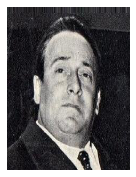

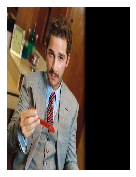

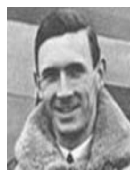

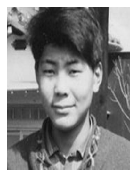

In [ ]:
for b in range(4): Image(i[b]).show()

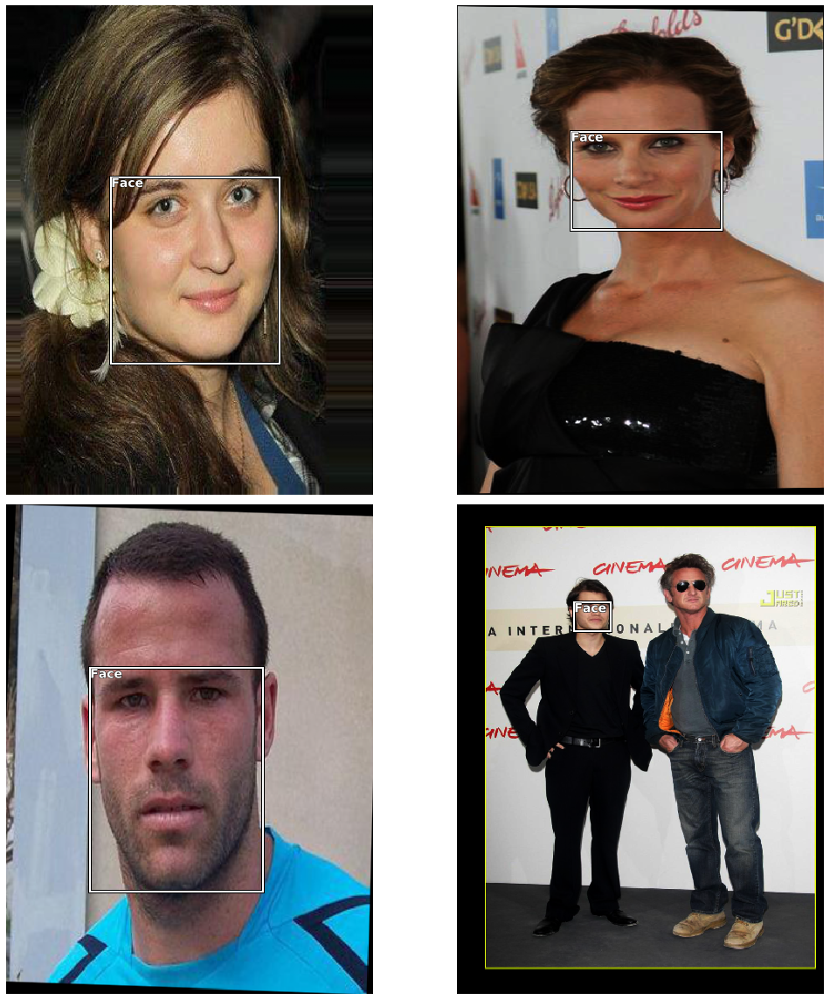

In [ ]:
data.show_batch(2, imgsize=8)

### Model

In [ ]:
#export
class UnetTypeConcat(nn.Module):
    def __init__(self, unpool_layer, conv_layer):
        super().__init__()
        # conv_layer: has to ...
        # unpool_layer: has to increase [h,w] -> [h*2, w*2]
        self.unpool = unpool_layer
        self.conv = conv_layer
        
    def forward(self, e, d): # e/d - encoder/decoder output
        '''
        @param:  :encoder output
        @param:  :decoder output
        '''
        o = self.unpool(d)
        o = torch.cat((o, e), 1)
        return self.conv(o)

In [ ]:
tensor(imagenet_stats[0]).reshape(1,3,1).expand_as(torch.zeros(1,3,10))

tensor([[[0.4850, 0.4850, 0.4850, 0.4850, 0.4850, 0.4850, 0.4850, 0.4850,
          0.4850, 0.4850],
         [0.4560, 0.4560, 0.4560, 0.4560, 0.4560, 0.4560, 0.4560, 0.4560,
          0.4560, 0.4560],
         [0.4060, 0.4060, 0.4060, 0.4060, 0.4060, 0.4060, 0.4060, 0.4060,
          0.4060, 0.4060]]])

In [ ]:
#export
class MaskHead(nn.Module):
    def __init__(self, conv_layer1, conv_layer2, conv_out):
        super().__init__()
        self.unpool1 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.unpool2 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
        self.conv_layer1 = conv_layer1
        self.conv_layer2 = conv_layer2
        self.conv_out = conv_out
        
    def forward(self, x_orig, o): # x_h / o_h = 4
        o = self.conv_layer1(self.unpool1(o)) # [b,nf1,h/2,w/2]
        o = self.conv_layer2(self.unpool2(o)) # [b,nf2,h,w]
        return self.conv_out(o)

In [ ]:
#export

# To work w/ ResNet18 change conv_layers in unet_concat:
# 3072 -> 768
# 640 -> 256
# 320 ->128
# (also pixelshuffle)

class EastModel(nn.Module):
    def __init__( self, pixelshuffle=False, conv_out=(listify(east_config.out_shape) == listify((8,8))), float_stats=None ):
        # float_stats.shape = [num_floats, 2], where 2 = (mean, std)
        super().__init__()
        self.conv_out = conv_out
        self.means = tensor(imagenet_stats[0]).reshape(1,3,1,1) # [R,G,B]
        self.stds = tensor(imagenet_stats[1]).reshape(1,3,1,1) # [R,G,B]
        
        if float_stats is not None:
            assert len(float_stats) == len(float_predictions)
            self.float_stats = True
            float_stats = tensor(float_stats)
            self.float_means = float_stats[:,0].reshape(1,-1,1,1)
            self.float_stds = float_stats[:,1].reshape(1,-1,1,1)
        else: self.float_stats = False
        
        if pixelshuffle:
            unpool1 = nn.Sequential(nn.PixelShuffle(2), nn.Conv2d(512, 512*4, kernel_size=1))
            unpool2 = nn.Sequential(nn.PixelShuffle(2), nn.Conv2d(32,  32*4,  kernel_size=1))
            unpool3 = nn.Sequential(nn.PixelShuffle(2), nn.Conv2d(16,  16*4,  kernel_size=1))
        else:
            unpool1 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
            unpool2 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
            unpool3 = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False)
            
#         self.resnet = models.resnet50(pretrained=True)
#         self.unet_block1 = UnetTypeConcat(unpool1, conv_layer(ni=3072, nf=128, ks=1))
#         self.unet_block2 = UnetTypeConcat(unpool2, conv_layer(ni=640,  nf=64,  ks=1))
#         self.unet_block3 = UnetTypeConcat(unpool3, conv_layer(ni=320,  nf=64,  ks=1))

        self.resnet = models.resnet18(pretrained=True) # (if using pixelshuffle u have to change those params too)
        self.unet_block1 = UnetTypeConcat(unpool1, conv_layer(ni=768, nf=128, ks=1))
        self.unet_block2 = UnetTypeConcat(unpool2, conv_layer(ni=256,  nf=64,  ks=1))
        self.unet_block3 = UnetTypeConcat(unpool3, conv_layer(ni=128,  nf=64,  ks=1))
        
        self.conv_bonus1 = conv_layer(ni=128,  nf=128, ks=3)
        self.conv_bonus2 = conv_layer(ni=64,   nf=64,  ks=3)
        self.conv1 = conv_layer(ni=64,   nf=32,  ks=3)
        self.conv2 = conv_layer(ni=32,   nf=32,  ks=3)
        self.conv_score = conv_layer(ni=32, nf=1,                         ks=1, norm_type=None, use_activ=False)
        self.conv_geo   = conv_layer(ni=32, nf=4,                         ks=1, norm_type=None, use_activ=False)
        self.conv_bin   = conv_layer(ni=32, nf=len(binary_predictions),   ks=1, norm_type=None, use_activ=False)
        self.conv_float = conv_layer(ni=32, nf=len(float_predictions),    ks=1, norm_type=None, use_activ=False)
#         self.conv_pts   = conv_layer(ni=32, nf=len(point_predictions),   ks=1, norm_type=None, use_activ=False)
#         self.conv_multi = conv_layer(ni=32, nf=len(binary_predictions),   ks=1, norm_type=None, use_activ=False)
#         self.conv10 = conv_layer(ni=32,  nf=1,   ks=1, norm_type=None, use_activ=False)
        
        if self.conv_out:
            self.conv_out = conv_layer(ni=32, nf=32, ks=3, stride=2, norm_type=None)
            
        # mask 
        self.conv_mask = conv_layer(ni=32, nf=1, ks=1, norm_type=None, use_activ=False)
#         self.conv_mask = MaskHead(conv_layer(ni=32, nf=16, ks=1), conv_layer(ni=16, nf=3, ks=1), 
#                                   conv_layer(ni=3, nf=1, ks=1, norm_type=None, use_activ=False))
        

    def forward(self, x_orig):
        b,c,h,w = x_orig.shape
        x = x_orig
        x = (x - self.means.to(x.device)) / self.stds.to(x.device) # normalize
        
        f = []
        for layer in list(self.resnet.children())[:-1]:
            x = layer(x)
            if type(layer) == torch.nn.Sequential: f.append(x)
        
        # [b,128,h/16,w/16] = unet_block1([b,1024,h/16,w/16], [b,2048,h/32,w/32])
        o = self.unet_block1(f[2], f[3])
        o = self.conv_bonus1(o)
        # [b,64,h/8,w/8] = unet_block1([b,512,h/8,w/8], [b,128,h/16,w/16])
        o = self.unet_block2(f[1], o)
        o = self.conv_bonus2(o)
        # [b,64,h/4,w/4] = unet_block1([b,256,h/4,w/4], [b,64,h/8,w/8])
        o = self.unet_block3(f[0], o)

        o = self.conv1(o)  # [b,32,h/4,w/4]
        o = self.conv2(o)  # [b,32,h/4,w/4]
        
        if self.conv_out: o = self.conv_out(o) # [b,32,h/8,w/8]
        
        score = self.conv_score(o) # [b,1,h/4,w/4]
        geo_map = self.conv_geo(o) # [b,4,h/4,w/4]
        
        score = nn.Sigmoid()(score)
        geo_map = nn.Sigmoid()(geo_map)*2
        geo = geo_map
        
        bin_pred = nn.Sigmoid()( self.conv_bin(o) )
        float_pred = nn.Tanh()( self.conv_float(o) )*3 # [b,n,h,w]
        mask_pred = self.conv_mask(o)
        mask_pred = F.interpolate(mask_pred, size=(h,w), mode='bilinear', align_corners=True)
        mask_pred = nn.Sigmoid()( mask_pred.view(b,h,w) )
        
        if self.float_stats:
            float_pred = (float_pred * self.float_stds) + self.float_means
        
        other_lbls = [bin_pred, float_pred]
        
        return score, geo, other_lbls, mask_pred

In [ ]:
float_stats = [[1,2] for _ in range(len(float_predictions))]
score, geo, other_lbls, mask = EastModel(float_stats=float_stats)(torch.zeros(2,3,east_config.HEIGHT,east_config.WIDTH))
for o in other_lbls: print(o.shape)
score.shape, geo.shape, mask.shape

torch.Size([2, 10, 128, 96])
torch.Size([2, 3, 128, 96])


(torch.Size([2, 1, 128, 96]),
 torch.Size([2, 4, 128, 96]),
 torch.Size([2, 512, 384]))

### Obj. Detection

In [ ]:
#export
# tlbr - top, left, bottom, right
# bb - bounding box
tlbr2hw = lambda bbs: bbs[:,2:] - bbs[:,:2] # [N,4] -> [N,2]

def intersection(bbs1, bbs2, normalize=False):
    ''' Calculates intersection area of bounding boxes
    @param: [N1,4]  :N1 tlbr coordinates
    @param: [N2,4]  :N2 tlbr coordinates
    @return [N1,N2] :area sizes for each coord combination
    '''
    N1, N2 = bbs1.size(0), bbs2.size(0)
    bbs1, bbs2 = bbs1.unsqueeze(1).expand(N1,N2,4), bbs2.unsqueeze(0).expand(N1,N2,4)
    intersection_tl_corner = torch.max(bbs1[...,:2], bbs2[...,:2]) # [N1,N2,2]
    intersection_br_corner = torch.min(bbs1[...,2:], bbs2[...,2:]) # [N1,N2,2]
    sizes = torch.clamp(intersection_br_corner - intersection_tl_corner, min=0) # [N1,N2,2]
    
    if normalize:
        hw = tlbr2hw(bbs1[:,0,:]) # [N1,2]
        sizes[...,:] /= hw.unsqueeze(1) # [N1,N2,2] * [N1,1,2]
    
    return sizes[...,0] * sizes[...,1] # [N1,N2]

In [ ]:
intersection( tensor([[.1,.1,.4,.4]]), tensor([[.2,.2,.5,.5]]) ) # should be area of tldr(2,2,4,4) -> 4

tensor([[0.0400]])

In [ ]:
#export
normalized_intersection = partial(intersection, normalize=True)

In [ ]:
normalized_intersection( tensor([[.1,.1,.4,.4]]), tensor([[.2,.2,.5,.5]]) )

tensor([[0.4444]])

In [ ]:
#export
def tlbr2cthw(bbs):
    ''' Convert top/left bottom/right format `boxes` to center/size corners
    @param: [N,4] :tlbr coordinates
    @return [N,4] :cthw coordinates
    '''
    center = (bbs[:,:2] + bbs[:,2:])/2 # [N,2]
    sizes = bbs[:,2:] - bbs[:,:2] # [N,2]
    return torch.cat([center, sizes], 1) # 

In [ ]:
#export
tlbr2hw = lambda bbs: bbs[:,2:] - bbs[:,:2] # [N,4] -> [N,2]
hw2area = lambda hw: hw[:,0] * hw[:,1] # [N,2] -> [N]

def IoU(bbs1, bbs2):
    ''' Calculates intersection area of bounding boxes
    @param: [N1,4]  :N1 tlbr coordinates
    @param: [N2,4]  :N2 tlbr coordinates
    @return [N1,N2] :area sizes for each coord combination
    '''
    inter = intersection(bbs1, bbs2) # [N1,N2]
    hw1, hw2 = tlbr2hw(bbs1), tlbr2hw(bbs2) # [N,2]
    bbs1_areas = hw2area(hw1).unsqueeze(1) # [N1,1]
    bbs2_areas = hw2area(hw2).unsqueeze(0) # [1,N2]
    union = bbs1_areas + bbs2_areas - inter
    return inter/(union+1e-8)

In [ ]:
IoU( tensor([[1,1,4,4]]), tensor([[1,1,4,4], [1,1,5,5]]) )

tensor([[1.0000, 0.5625]])

In [ ]:
#export
# a bit problematic w/ int input and by_iou=False
def match_anchors(anchors, targets, match_thr=0.01, bg_thr=0.01, by_iou=False):
    ''' Match `anchors` to targets. -1 is match to background, -2 is ignore
    @param: [N1,4]  :N1 tlbr coordinates
    @param: [N2,4]  :N2 tlbr coordinates
    @param: int     :if this < IoU -> this match is a match (int index of match in targets)
    @param: int     :if this > IoU -> this match is a background (int -1)
    @param: bool    :to
    @return [N1]    :every match from anchors to targets index (if doesnt exist it is -2/-1)
    '''
    f = IoU if by_iou else normalized_intersection
    ious = f(anchors, targets) # [N1,N2]
#     print(anchors)
#     print(targets)
#     print('ious: \n', ious)
    matches = anchors.new(anchors.size(0)).zero_().long() - 2
#     matches = torch.zeros(anchors.size(0)).zero_().long() - 2
    
    if ious.shape[1] == 0:
        print('ious.shape[1] == 0')
        return matches
    
    iou, idxs = torch.max(ious, dim=1) # [N1]
    matches[iou < bg_thr] = -1
    matches[iou > match_thr] = idxs[iou > match_thr]
    
    return matches

In [ ]:
# a bit problematic w/ int input and by_iou=False
match_anchors( tensor([[.1,1,4,4], [.1,1,5,5]]), tensor([[.1,1,5,5], [.1,1,3,3], [.1,1,4,4]]) )

tensor([2, 0])

In [ ]:
#export
def create_grid(size):
    ''' Creates a x,y grid of size `size`, coords start from -1 to 1
    @param: tuple(H,W) :tuple of 2 ints H(height), W(width)
    @return [H,W,4]    :tlbr coords for each (h,w) cell 
    '''
    H, W = size if is_tuple(size) else (size,size)
    grid = FloatTensor(H, W, 4)
    
    # not precise, but good enough
    linear_points_left = torch.linspace(0, 1-1/W, W) # [0, 1]
    linear_points_right = linear_points_left + 1/W
    linear_points_top = torch.linspace(0, 1-1/H, H) # [0, 1]
    linear_points_btm = linear_points_top + 1/H
    
    grid[:, :, 0] = linear_points_top.unsqueeze(1).expand(H,W)
    grid[:, :, 1] = linear_points_left.unsqueeze(0).expand(H,W)
    grid[:, :, 2] = linear_points_btm.unsqueeze(1).expand(H,W)
    grid[:, :, 3] = linear_points_right.unsqueeze(0).expand(H,W)
    return grid*2-1

In [ ]:
# models.SqueezeNet()

In [ ]:
grid = create_grid((4,10))
for i in range(5,10):
    print(grid[0,i])

tensor([-1.0000e+00, -5.9605e-08, -5.0000e-01,  2.0000e-01])
tensor([-1.0000,  0.2000, -0.5000,  0.4000])
tensor([-1.0000,  0.4000, -0.5000,  0.6000])
tensor([-1.0000,  0.6000, -0.5000,  0.8000])
tensor([-1.0000,  0.8000, -0.5000,  1.0000])


In [ ]:
#export
anchors = create_grid((east_config.HEIGHT//4, east_config.WIDTH//4)).view(-1,4)

In [ ]:
#export
def _draw_outline(o:Patch, lw:int):
    "Outline bounding box onto image `Patch`."
    o.set_path_effects([patheffects.Stroke(
        linewidth=lw, foreground='black'), patheffects.Normal()])

def _draw_rect(ax:plt.Axes, b:Collection[int], color:str='white', text=None, text_size=14):
    "Draw bounding box on `ax`."
    patch = ax.add_patch(patches.Rectangle(b[:2], *b[-2:], fill=False, edgecolor=color, lw=2))
    _draw_outline(patch, 4)
    if text is not None:
        patch = ax.text(*b[:2], text, verticalalignment='top', color=color, fontsize=text_size, weight='bold')
        _draw_outline(patch,1)

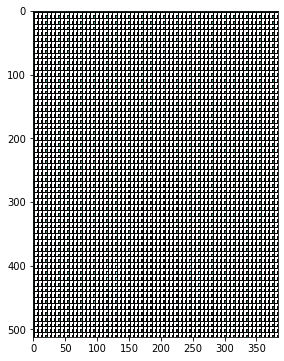

In [ ]:
anchors = create_grid((56,56)).view(-1,4)

fig,ax = plt.subplots(figsize=(6,6))
ax.imshow(image2np(data.valid_ds[0][0].data))

anchors = tlbr2cthw(anchors)

for i, bbox in enumerate(anchors):
    bb = bbox.numpy()
    x = (bb[0] + 1) * east_config.WIDTH / 2 
    y = (bb[1] + 1) * east_config.HEIGHT / 2 
    w = bb[2] * east_config.WIDTH / 2
    h = bb[3] * east_config.HEIGHT / 2
    
    rect = [x,y,w,h]
    _draw_rect(ax,rect)

In [ ]:
x, y = data.one_batch(DatasetType.Train, True, True)

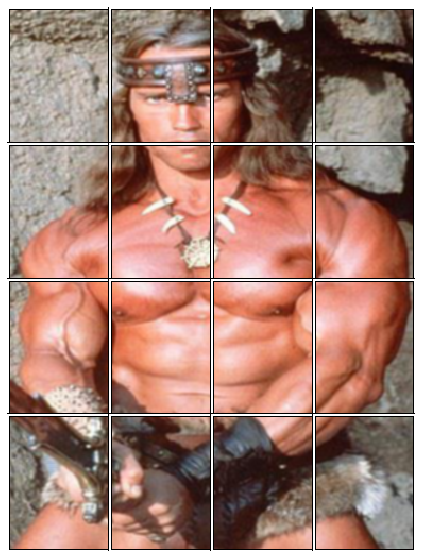

In [ ]:
anchors = create_grid((4,4)).view(-1,4)

for image, bboxes, labels in zip(x, y[0], y[1]):
    image = Image(image.float().clamp(min=0, max=1))
    imageBB = ImageBBox.create(*image.size, tensor(anchors), scale=False)
    image.show(y=imageBB, figsize=(10,10))
    break

In [ ]:
#export
def cthw2tlbr(boxes):
    "Convert center/size format `boxes` to top/left bottom/right corners."
    top_left = boxes[:,:2] - boxes[:,2:]/2
    bot_right = boxes[:,:2] + boxes[:,2:]/2
    return torch.cat([top_left, bot_right], 1)

def show_anchors_on_images(data, anchors, figsize=(15,15)):
    all_boxes = []
    all_labels = []
    x, y = data.one_batch(DatasetType.Train, True, True)
    for image, bboxes, labels in zip(x, y[0], y[1]):
        image = Image(image.float().clamp(min=0, max=1))

        # 0=not found; 1=found; found 2=anchor
        processed_boxes = []
        processed_boxes_gt = []
        processed_boxes_bg = []
        processed_labels = []
        processed_labels_gt = []
        a = 0
        bgs = torch.zeros(len(anchors), dtype=bool) + 1
        for gt_box in bboxes[labels > 0]:
            matches = match_anchors(anchors, gt_box[None, :])
            non_bg = matches >= 0
            a += non_bg.sum()
#             print('1)', non_bg.sum(), (matches >= -1).sum(), (matches >= -2).sum())
            if non_bg.sum() != 0:
                processed_boxes_gt.append(to_np(gt_box))
                processed_labels_gt.append(2)
                for bb in anchors[non_bg]:
                    processed_boxes.append(to_np(bb))
                    processed_labels.append(3)
                bgs[non_bg] = 0
            else:
                processed_boxes.append(to_np(gt_box))
                processed_labels.append(0)
                val, idx = torch.max(IoU(anchors, gt_box[None, :]), 0)
                best_fitting_anchor = anchors[idx][0]
                processed_boxes.append(to_np(best_fitting_anchor))
                processed_labels.append(1)
            if a > 500:
                break
        all_boxes.extend(processed_boxes)
        all_labels.extend(processed_labels)

        processed_boxes = np.array(processed_boxes)
        processed_labels = np.array(processed_labels)
        
#         print('2)', np.unique(processed_labels, return_counts=True))

        _, ax = plt.subplots(nrows=1, ncols=3, figsize=figsize)
        ax[0].set_title("Matched Anchors")
        ax[1].set_title("Actual GT")
        ax[2].set_title("BG Anchors")
        
        # Anchors
        imageBB = ImageBBox.create(*image.size, tensor(processed_boxes[processed_labels > 1]),
#                                    labels=processed_labels[processed_labels > 1],
                                   classes=["", "", "", ""], scale=False)
#                                        classes=["", "", "Match", "Anchor"], scale=False)

        image.show(ax=ax[0], y=imageBB)
        
        # Actual
        imageBB = ImageBBox.create(*image.size, tensor(processed_boxes_gt),
#                                    labels=[processed_labels[0]],
                                   classes=["", "", "", ""], scale=False)
#                                        classes=["", "", "Match", "Anchor"], scale=False)
        image.show(ax=ax[1], y=imageBB)
        
        # BG Anchors
        imageBB = ImageBBox.create(*image.size, tensor(anchors[bgs == 1][1000:2000]),
                                   classes=["", "", "", ""], scale=False)
        image.show(ax=ax[2], y=imageBB)
        break

#     return np.array(all_boxes), np.array(all_labels)

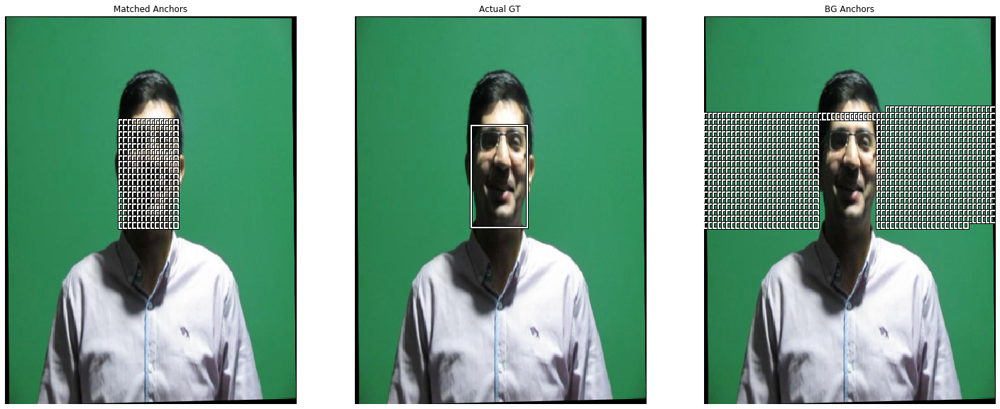

In [ ]:
anchors = create_grid((64,64)).view(-1,4)
show_anchors_on_images(data, anchors, figsize=(25,25))

In [ ]:
#export
def tlbr2cthw(boxes): # [N,4] -> [N,4]
    center = (boxes[:,:2] + boxes[:,2:])/2
    sizes = boxes[:,2:] - boxes[:,:2]
    return torch.cat([center, sizes], 1)


def bbox_to_target(bboxes, anchors):
    ''' Return the target of the model on `anchors` for the `bboxes`
    @param: [N,4] :N tlbr coordinates (true bboxes), (bboxes must match anchors)
    @param: [N,4] :N tlbr coordinates (selected anchors)
    @return [N,4] :distance of how much bboxes are from anchors
    '''
    bboxes, anchors = tlbr2cthw(bboxes), tlbr2cthw(anchors)
    t_centers = (bboxes[...,:2] - anchors[...,:2]) / anchors[...,2:]
    t_sizes = torch.log(bboxes[...,2:] / anchors[...,2:] + 1e-8)
    return torch.cat([t_centers, t_sizes], -1)#.div_(bboxes.new_tensor([[0.1, 0.1, 0.2, 0.2]]))

In [ ]:
bbox_to_target(tensor([[.2,.2,.4,.4], [.1,.1,.5,.5], [.1,.1,.5,.5]]), tensor([[.2,.2,.5,.5], [.1,.1,.3,.3], [.1,.1,.5,.5]]) )

tensor([[-0.1667, -0.1667, -0.4055, -0.4055],
        [ 0.5000,  0.5000,  0.6931,  0.6931],
        [ 0.0000,  0.0000,  0.0000,  0.0000]])

In [ ]:
#export
# tlbr to center coords
tlbr2cc = lambda boxes: (boxes[:,:2] + boxes[:,2:])/2 # [N,4] -> [N,2]

# Override
def bbox_to_target(bboxes, anchors):
    ''' Return the target of the model on `anchors` for the `bboxes`
    @param: [N,4] :N tlbr coordinates (true bboxes), (bboxes must match anchors)
    @param: [N,4] :N tlbr coordinates (selected anchors)
    @return [N,4] :distance of how much bboxes are from anchors
    '''
    a_centers = tlbr2cc(anchors)
    return torch.cat([a_centers - bboxes[...,:2], bboxes[...,2:] - a_centers], -1) # .div_(bboxes.new_tensor([[0.1, 0.1, 0.1, 0.1]]))

In [ ]:
bbox_to_target(tensor([[.2,.2,.4,.4], [.1,.1,.5,.5], [.1,.1,.5,.5]]), tensor([[.2,.2,.5,.5], [.1,.1,.3,.3], [.1,.1,.5,.5]]) )

tensor([[0.1500, 0.1500, 0.0500, 0.0500],
        [0.1000, 0.1000, 0.3000, 0.3000],
        [0.2000, 0.2000, 0.2000, 0.2000]])

In [ ]:
#export
def prepare_bboxes(anchors, bbox_true, bbox_pred, matches=None):
    ''' Return the target of the model on `anchors` for the `bboxes`
    @param: [N1,4] :tlbr coordinates (all anchors), N1 = H x W
    @param: [N2,4] :tlbr coordinates (true bboxes)
    @param: [N1,4] :tlbr coordinates (nn output bboxes)
    @param: [N3,4] :optional for caching
    @return ([N3,4], [N3,4], [N3,4]) or None :bbox_true, bbox_pred, matches (for caching)
    '''
    if matches is None: matches = match_anchors(anchors, bbox_true) # [N3, 4]
    non_bg = matches >= 0 # [N3, 4] (non background)

    if non_bg.sum() == 0:
#         print('non_bg.sum() == 0') # creates a bit of spam (0-2 per epoch)
        return None, None, None

    bbox_pred = bbox_pred[non_bg] # [N3,4]
    bbox_true = bbox_true[matches[non_bg]] # [N3,4] (matches return bbox_true indexes)
    anchors = anchors[non_bg] # [N3,4]
    return bbox_to_target(bbox_true, anchors), bbox_pred, matches

In [ ]:
#export
def prepare_labels(y_true, y_pred, matches):
    ''' Prepare the probabilities of target and prediction of the model
    @param: [N1]           :
    @param: [H/4 x W/4, 1] :
    @param: [H/4 x W/4]    :
    @return [N2], [N2, 1]  :
    '''
    if matches is None: matches = torch.zeros_like(y_pred).squeeze()
    non_ignore = matches >= -1
    if non_ignore.sum() != matches.size(0):
        print('non_ignore.sum() != matches.size(0)', non_ignore.sum(), matches.size(0))
    
    target = y_true.new_zeros(len(matches)).float()
    non_bg = matches >= 0
    target[non_bg] = 1
    
    return target[non_ignore][:, None], y_pred[non_ignore]

In [ ]:
#export
class BBLossMetrics(LossMetrics):
    def on_batch_end(self, last_target, train, **kwargs):
        "Update the metrics if not `train`"
        if train: return
        bs = last_target[0].size(0) # CHANGED
        for name in self.names:
            self.metrics[name] += bs * self.learn.loss_func.metrics[name].detach().cpu()
        self.nums += bs

In [ ]:
#export
def target_to_bbox(output, anchors):
#     output.mul_(output.new_tensor([[0.1, 0.1, 0.1, 0.1]]))
    a_centers = tlbr2cc(anchors)
    return torch.cat([a_centers - output[...,:2], a_centers + output[...,2:]], -1)

In [ ]:
#export
def nms(boxes, scores, threshold=0.2):
    ''' non maximum suppression
    @param: [N,4]
    @param: [N]
    @return [N1]
    '''
    sorted_idx = scores.argsort(descending=True) # [N]
    boxes, scores = boxes[sorted_idx], scores[sorted_idx]
    to_keep, indexes = [], torch.LongTensor(range(len(scores))) # [], [N]
    while len(scores) > 0:
        # put in highest scored index
        to_keep.append(sorted_idx[indexes[0]])
        # calculate IoU of highest_scored_box vs all_boxes
        ious = IoU(boxes, boxes[0].view(1,4)).squeeze() # [N]
        other_boxes = ious <= threshold # [N] (not the same boxes)
        if other_boxes.sum() == 0: break
        if other_boxes.sum() == len(boxes):
            if len(indexes) < 3: break
            boxes, scores, indexes = boxes[1:], scores[1:], indexes[1:]
            continue
        boxes, scores, indexes = boxes[other_boxes], scores[other_boxes], indexes[other_boxes]
    
    return LongTensor(to_keep)

In [ ]:
#export
def _unpad(bbox_true, y_true, pad_idx=0):
    ''' [N_max,4], [N_max] -> [N1,4], [N1] '''
    i = torch.min(torch.nonzero(y_true - pad_idx)) if sum(y_true)>0 else 0
    return bbox_true[i:], y_true[i:] + pad_idx

def check_overlap(i_true, _list, is_overlaping):
    for i_pred in _list:
        if is_overlaping[i_pred, i_true]:
            return i_pred
    return None

def calc_precision_recall(bbox_pred, bbox_true, iou_thresh=0.5):
    ''' [P,4], [T,4] (Preds, Trues)'''
    num_preds, num_trues = len(bbox_pred), len(bbox_true)

    ious = IoU(bbox_pred, bbox_true)
    is_overlaping = ious > iou_thresh
    
    correct = 0
    pred_idxes =list(range(len(bbox_pred)))
    for i_true in range(len(bbox_true)):
        i_overlap = check_overlap(i_true, pred_idxes, is_overlaping)
        if i_overlap is not None:
            pred_idxes.remove(i_overlap)
            correct += 1
            
    precision = correct / num_preds
    recall = correct / num_trues
    # print(precision, recall, correct, num_preds)
    return precision, recall

def F1(last_output, bbox_true_b, y_true_b, *other, detect_thresh=0.8, iou_thresh=0.5, **kwargs):
    other_true_b, mask_true_b = other[:-1], other[-1]
    y_pred_b, bbox_pred_b, other_pred_b, mask_pred_b = last_output
    if len(y_true_b) == 0: return tensor(0.)
    
    f1 = 0
    for y_pred, bbox_pred, y_true, bbox_true in zip(y_pred_b, bbox_pred_b, y_true_b, bbox_true_b):
        
        # 1.get true bbox
        bbox_true, y_true = _unpad(bbox_true, y_true) # [N1,4]

        # 2. get pred bbox
        bbox_pred = bbox_pred.permute(1,2,0).view(-1,4)
        y_pred = y_pred.view(-1,1)

        bbox_pred = target_to_bbox(bbox_pred, anchors.to(y_pred.device))
    #     bbox_pred = bbox_pred.to('cpu')

        detect_mask = y_pred.squeeze() > detect_thresh # [H x W]
        if detect_mask.sum() == 0:
#             print('iou_metric: detect_mask.sum() == 0') # (too much spam when network start learning)
            return tensor(0)

        keep_idxes = nms(bbox_pred[detect_mask], y_pred[detect_mask].view(-1), threshold=0.2)
        bbox_pred = bbox_pred[detect_mask][keep_idxes] # [N2,4]

        # 3. calc result
        precision, recall = calc_precision_recall(bbox_pred, bbox_true, iou_thresh=iou_thresh)
        if precision + recall < 0.001: f1 += 0.
        else: f1 += 2 * (precision * recall) / (precision + recall)
    return tensor(f1 / len(y_true_b))

In [ ]:
def get_other_lbl_pred_str(preds, names, mult=100, name_idx=0):
    out_str = ""
    for fs in preds:
        for f,name in zip(fs, names):
            out_str += str(name)[:name_idx] + str(int(f*mult)) + ";"
    return out_str

In [ ]:
def show_examples(learner, image_count=4, detect_thresh=0.95, show_bbox=True, datatype=DatasetType.Valid, bin_newline=True):
    img_batch, target_batch = learner.data.one_batch(datatype, False, False, False)
    
    print('bin:', ';'.join(binary_predictions))
    
    prediction_batch = learner.model(img_batch[:image_count])
    class_pred_batch, bbox_pred_batch, other_pred_batch, mask_pred_batch = prediction_batch[:4]
    bin_pred_batch, float_pred_batch = other_pred_batch[:2]

    bbox_gt_batch, class_gt_batch, *other = target_batch[0][:image_count], target_batch[1][:image_count], target_batch[2:]
    other_gt_batch, mask_gt_batch = other[0][:-1], other[0][-1] # WTF: why [0]?
    bin_gt_batch, float_gt_batch = other_gt_batch[0], other_gt_batch[1]
    
    for img, bbox_gt, class_gt, bin_gt, float_gt, clas_pred, bbox_pred, bin_pred, float_pred in list(
        zip(img_batch, bbox_gt_batch, class_gt_batch, bin_gt_batch, float_gt_batch,
            class_pred_batch, bbox_pred_batch, bin_pred_batch, float_pred_batch)
    ):
        if hasattr(learner.data, 'stats'):
            img = Image(learner.data.denorm(img))
        else:
            img = Image(img)
        image = img

        bbox_pred = bbox_pred.permute(1,2,0).view(-1,4)
        bin_pred = bin_pred.permute(1,2,0)
        bin_pred = bin_pred.view(-1,bin_pred.shape[-1])
        float_pred = float_pred.permute(1,2,0)
        float_pred = float_pred.view(-1,float_pred.shape[-1])
        y_pred = clas_pred.view(-1,1)
        
        bbox_pred = target_to_bbox(bbox_pred, anchors.to(y_pred.device))
        bbox_pred = bbox_pred.to('cpu')

        detect_mask = y_pred.squeeze() > detect_thresh # [H x W]
        print('total found bbs:', detect_mask.sum())
        if detect_mask.sum() == 0: break

        _, ax = plt.subplots(nrows=1, ncols=3, figsize=(20,15))

        ax[2].set_title("Found Anchors")
        anchs = tensor(anchors[detect_mask])
        imageBB = ImageBBox.create(*image.size, anchs, scale=False)
        image.show(ax=ax[2], y=imageBB)
        
        if show_bbox:
            t = bbox_pred[detect_mask]

            keep_idxes = nms(t, y_pred[detect_mask].view(-1), threshold=0.2)
            preds = tensor(t[keep_idxes])
            print('after nms:', len(preds))
            bins = tensor(bin_pred[detect_mask][keep_idxes])
            floats = tensor(float_pred[detect_mask][keep_idxes])
#             bins = tensor(bin_pred[detect_mask]).mean(dim=0).view(1,-1)
#             floats = tensor(float_pred[detect_mask]).mean(dim=0).view(1,-1)
            bin_str = get_other_lbl_pred_str(bins, binary_predictions, name_idx=1)
            if bin_newline: bin_str = bin_str[:len(bin_str)//2] + '\n' + bin_str[len(bin_str)//2:]
            float_str = get_other_lbl_pred_str(floats, float_predictions)

            ax[0].set_title("Corresponding anchors BBox \n {} \n {}".format(bin_str,float_str))
            imageBB = ImageBBox.create(*image.size, preds, scale=False)
            image.show(ax=ax[0], y=imageBB)

        bbox_true, bbox_pred_2, matches = prepare_bboxes(anchors.to(y_pred.device), bbox_gt, bbox_pred)
        bbox_true = target_to_bbox(bbox_true.to('cpu'), anchors[matches >= 0].to('cpu'))
        
        # TODO: WTF float_gt.shape = bin_gt.shape = [21] ????
        bin_str = get_other_lbl_pred_str(bin_gt, binary_predictions, name_idx=1)
        if bin_newline: bin_str = bin_str[:len(bin_str)//2] + '\n' + bin_str[len(bin_str)//2:]
        float_str = get_other_lbl_pred_str(float_gt, float_predictions)
        
        ax[1].set_title("True targets \n {} \n {}".format(bin_str,float_str))
        trues = tensor(bbox_true)
        imageBB = ImageBBox.create(*image.size, trues[::10], scale=False)
        image.show(ax=ax[1], y=imageBB)

In [ ]:
def show_mask_examples(learner, image_count=4, datatype=DatasetType.Valid):
    img_batch, target_batch = learner.data.one_batch(datatype, False, False, False)
    
    prediction_batch = learner.model(img_batch[:image_count])
    class_pred_batch, bbox_pred_batch, other_pred_batch, mask_pred_batch = prediction_batch[:4]
    bin_pred_batch, float_pred_batch = other_pred_batch[:2]

    bbox_gt_batch, class_gt_batch, *other = target_batch[0][:image_count], target_batch[1][:image_count], target_batch[2:]
    other_gt_batch, mask_gt_batch = other[0][:-1], other[0][-1] # WTF: why [0]?
    bin_gt_batch, float_gt_batch = other_gt_batch[0], other_gt_batch[1]
    
    for img, mask_true, mask_pred  in list(zip(img_batch, mask_gt_batch, mask_pred_batch)):
        if hasattr(learner.data, 'stats'):
            img = Image(learner.data.denorm(img))
        else:
            img = Image(img)
        image = img

        _, ax = plt.subplots(nrows=1, ncols=3, figsize=(20,15))

        ax[1].set_title("Image")
        image.show(ax=ax[1])
        
        ax[2].set_title("True Background")
        Image(mask_true[None]).show(ax=ax[2])
        
        ax[0].set_title("Pred Background")
        Image(mask_pred.detach()[None]).show(ax=ax[0])

In [ ]:
#export
def iou_loss(y_pred_geo, y_true_geo, eps=1.0):
    '''
    @param: [N,4] :
    @param: [N,4] :
    '''
    # d1 -> top, d2->left, d3->bottom, d4->right
    d1_true, d2_true, d3_true, d4_true = torch.split(y_true_geo, 1, 1) # [N,1] x 4
    d1_pred, d2_pred, d3_pred, d4_pred = torch.split(y_pred_geo, 1, 1) # [N,1] x 4
    area_true = (d1_true + d3_true) * (d2_true + d4_true)
    area_pred = (d1_pred + d3_pred) * (d2_pred + d4_pred)
    inter_width = torch.min(d2_true, d2_pred) + torch.min(d4_true, d4_pred)
    inter_height = torch.min(d1_true, d1_pred) + torch.min(d3_true, d3_pred)
    area_intersect = inter_width * inter_height
    area_union = area_true + area_pred - area_intersect
    L_AABB = -torch.log((area_intersect + eps) / (area_union + eps))
    return L_AABB

def dice_loss(y_pred, y_true):
    inter = torch.sum(y_true * y_pred)
    union = torch.sum(y_true) + torch.sum(y_pred) + 1e-5
    return 1. - (2 * inter / union)

In [ ]:
#export
def encode_class(idxs, n_classes):
    target = idxs.new_zeros(len(idxs), n_classes).float()
    mask = idxs != 0
    i1s = LongTensor(list(range(len(idxs))))
    target[i1s[mask],idxs[mask]-1] = 1
    return target

class SigmaL1SmoothLoss(nn.Module):
    def forward(self, output, target):
        reg_diff = torch.abs(target - output)
        reg_loss = torch.where(torch.le(reg_diff, 1/9), 4.5 * torch.pow(reg_diff, 2), reg_diff - 1/18)
        return reg_loss.mean()
    
class RetinaNetFocalLoss(nn.Module):
    def __init__(self, anchors: Collection[float], gamma=1.0, pad_idx=0, class_weights=[0.3,0.3,0.2,0.2], mask_weight=1.0):
        super().__init__()
        self.class_weights, self.mask_weight = class_weights, mask_weight
        assert tensor(self.class_weights).sum() == 1
        self.gamma, self.pad_idx = gamma, pad_idx
        self.anchors, self.metric_names = anchors, ['Lbbox', 'Ly', 'Lmask', 'Lbin', 'Lfloat']

    def _unpad(self, bbox_true, y_true): # TODO: work w/ other_labels_true
        ''' [N_max,4], [N_max] -> [N1,4], [N1] '''
        i = torch.min(torch.nonzero(y_true - self.pad_idx)) if sum(y_true)>0 else 0
        return bbox_true[i:], y_true[i:] + self.pad_idx

    def _cls_loss(self, y_pred, y_true):
        ''' [N,1], [N,1] '''
#         return dice_loss(y_pred, y_true)
#         return F.binary_cross_entropy(y_pred, y_true)
        # CE = -log(pt), where pt is prob of correct class
        CE = F.binary_cross_entropy(y_pred, y_true, reduction='none')
        pt = torch.exp(-CE)
        return torch.mean( (1-pt)**self.gamma * CE )
    
    def _reg_loss(self, bbox_pred, bbox_true, weights):
        loss = iou_loss(bbox_pred*256, torch.clamp(bbox_true, min=0)*256)
        return torch.mean(loss * weights)
    
    def _bin_loss(self, bin_pred, bin_true, weights=None):
        ''' [N,num_bin], [F,num_bin], [N,1] ''' # NOTE: works only w/ F = 1
        return F.binary_cross_entropy(bin_pred, bin_true, reduction='mean')
#         bin_losses = torch.zeros(bin_true.shape[1]).to(bin_pred.device)
#         print(float(bin_pred[:,-1].mean()), float(bin_true[:,-1].mean()))
#         for i in range(bin_true.shape[1]):
#             bin_losses[i] = nn.BCELoss(reduction='mean')(bin_pred[:,i], bin_true.expand_as(bin_pred)[:,i])
#         loss = F.binary_cross_entropy(bin_pred, bin_true.expand_as(bin_pred), reduction='none') # [N,num_bin]
#         bin_losses = torch.mean(loss, dim=0)
#         return torch.mean(bin_losses)
    
    def _float_loss(self, float_pred, float_true, weights=None):
        ''' [N,num_bin], [F,num_bin], [N,1] ''' # NOTE: works only w/ F = 1
        return F.mse_loss(float_pred, float_true, reduction='mean')
#         loss = F.mse_loss(float_pred, float_true.expand_as(float_pred), reduction='none') # [N,num_float]
#         float_losses = torch.mean(loss, dim=0)
#         return torch.mean(float_losses)
    
    def _one_loss(self, y_pred, bbox_pred, other_pred, y_true, bbox_true, other_true):
        ''' [N,C], [N,4], list, [F], [F,4], list '''
        bbox_true, y_true = self._unpad(bbox_true, y_true) # [F2,4], [F2]
        bbox_true, bbox_pred, matches = prepare_bboxes(self.anchors, bbox_true, bbox_pred) # [N2,4], [N2,4], [N]
        if matches is None or matches is None: return tensor(0.)
        y_true, y_pred = prepare_labels(y_true, y_pred, matches) # [N2], [N2]
#         print('after', y_pred.shape, bbox_pred.shape, y_true.shape, bbox_true.shape)
        y_loss = self._cls_loss(y_pred, y_true)
        face_idxes = matches[matches >= 0]
        y_pred = y_pred[face_idxes]
#         print('ypred', y_pred.shape)
        weights = -torch.log( torch.clamp( 1-y_pred, min=1e-3, max=0.7 ) )
#         weights = y_pred + 0.3
        bb_loss = self._reg_loss(bbox_pred, bbox_true, weights)
#         bin_loss = self._bin_loss(other_pred[0][face_idxes], other_true[0], weights)
#         f_offset = 6*3 # std*3 (float offset)
#         float_loss = self._float_loss(other_pred[1][face_idxes]/f_offset, other_true[1]/f_offset, weights)
        losses = [bb_loss, y_loss] + [0.]*(len(self.metric_names)-2)
        self.metrics += tensor(losses)
        out_loss = torch.tensor(0, dtype=torch.float32).to(y_pred.device)
        for w,loss in zip(self.class_weights, losses): out_loss += w*loss
        return out_loss
    
    def _mask_loss(self, mask_pred, mask_true):
#         mask_hard = torch.zeros_like(mask_true)
#         mask_hard[ mask_true > 0.5 ] = 1
#         loss_hard = F.binary_cross_entropy(mask_pred, mask_hard, reduction='none')
        loss_soft = F.binary_cross_entropy(mask_pred, mask_true, reduction='none')
        return torch.mean(loss_soft)

    def forward(self, nn_output, bbox_true, y_true, *other):
        other_true, mask_true = other[:-1], other[-1]
        y_pred, bbox_pred, other_pred, mask_pred = nn_output
        bin_true, float_true = other_true
        bin_pred, float_pred = other_pred
        '''
        @param: [B, 1, H/4, W/4] :probability for each h,w cell
        @param: [B, 4, H/4, W/4] :bboxes for each h,w cell
        @param: [B, N_max, 4]    :true bboxes
        @param: [B, N_max]       :true label (1/0)
        @param: [B, H, W]
        '''
        if bbox_true.device != self.anchors.device:
            self.anchors = self.anchors.to(y_pred.device)

        loss = torch.tensor(0, dtype=torch.float32).to(y_pred.device)
        self.metrics = tensor([0.]*len(self.metric_names))
        for i, (yp, bp, yt, bt) in enumerate(zip(y_pred, bbox_pred, y_true, bbox_true)):
            olbls_p, olbls_t = [], []
#             olbls_p = map(lambda lbl: lbl[i].permute(1,2,0), other_pred) # all shape: [h,w,N], N - variable
#             olbls_p = map(lambda lbl: lbl.view(-1, lbl.shape[-1]), olbls_p)
#             olbls_t = map(lambda lbl: lbl[i], other_true) # all shape: [F,N], F - num faces
            loss += self._one_loss(yp.view(-1,1), bp.permute(1,2,0).view(-1,4), list(olbls_p), yt, bt, list(olbls_t))
        
        bs = y_true.size(0)
        mask_loss = self._mask_loss(mask_pred, mask_true) * self.mask_weight * bs
#         mask_loss = tensor(0.).to(y_pred.device)
        
        # NOTE: x_true.squeeze() works only w/ 1 face
#         try:
        bin_true = (bin_true.squeeze()[:,:,None,None]).expand_as(bin_pred) # [b,num_bin,h,w]
        float_true = (float_true.squeeze()[:,:,None,None]).expand_as(float_pred) # [b,num_float,h,w]

        faces_pred = y_pred.detach() > 0.5
        mask = faces_pred.expand_as(bin_pred)
        bin_loss = self._bin_loss(bin_pred[mask], bin_true[mask]) * bs # TODO: * weight
#         bin_loss = tensor(0.).to(y_pred.device)
        f_offset = 6*3 # std*3 (float offset)
        float_pred, float_true = float_pred/f_offset, float_true/f_offset
        mask = faces_pred.expand_as(float_pred)
        float_loss = self._float_loss(float_pred[mask], float_true[mask]) * bs # TODO: * weight
#         except:
#             print(bin_true.shape, float_true.shape)
#             bin_loss = tensor(0.).to(y_pred.device)
#             float_loss = tensor(0.).to(y_pred.device)
        
        loss += (mask_loss + bin_loss + float_loss)
        self.metrics[2:] = tensor([mask_loss, bin_loss, float_loss])
        self.metrics = dict(zip(self.metric_names, [m/bs for m in self.metrics]))
        return loss/bs

In [ ]:
#export
class MSEloss(RetinaNetFocalLoss):
    def _reg_loss(self, bbox_pred, bbox_true, y_pred):
        return nn.MSELoss()(bbox_pred, bbox_true)
    
    def _one_loss(self, y_pred, bbox_pred, y_true, bbox_true):
        ''' [N,C], [N,4], [N_max], [N_max,4] -> float, float '''
        bbox_true, y_true = self._unpad(bbox_true, y_true) # [N1,4], [N1]
        bbox_true, bbox_pred, matches = prepare_bboxes(self.anchors, bbox_true, bbox_pred) # [N2,4], [N2,4]
        if matches is None or matches is None: return tensor(0.)
        y_true, y_pred = prepare_labels(y_true, y_pred, matches) # [N2], [N2]
        bb_loss = self._reg_loss(bbox_pred, bbox_true, y_pred[matches[matches >= 0]])
        return bb_loss

In [ ]:
anchors = create_grid((east_config.HEIGHT//output_shape_dx[0], east_config.WIDTH//output_shape_dx[1])).view(-1,4)
model = EastModel()

In [ ]:
#export
mse = MSEloss(anchors)
def MSE(last_output, bbox_true, y_true, **kwargs):
    return mse(last_output, bbox_true, y_true)

In [ ]:
# # # either load or create new learner
# learner = load_inference('east_bbox_10x3')
# learner.data = data

In [ ]:
# loss = RetinaNetFocalLoss(anchors, class_weights=[0.25,0.25,0.25,0.25])
loss = RetinaNetFocalLoss(anchors, class_weights=[.5,.5,0,0], mask_weight=1.)
# data = create_data(src, transforms=(train_transforms, valid_transforms))
data = create_data(src, transforms=None)
learner = Learner(data, model, loss_func=loss, callback_fns=[ShowGraph, BBLossMetrics], metrics=[F1])
learner.path = Path('../models')

In [ ]:
list_layers = [
    learner.model.resnet,
    learner.model.unet_block1,
#     learner.model.conv_bonus1,
    learner.model.unet_block2,
#     learner.model.conv_bonus2,
    learner.model.unet_block3,
    learner.model.conv1,
    learner.model.conv2,
    learner.model.conv_score,
    learner.model.conv_geo
]

learner.split(list_layers)
num_groups = len(learner.layer_groups)
print('Learner split in',num_groups,'groups')

Learner split in 8 groups


In [ ]:
# learner.freeze_to(1)
learner.unfreeze()

epoch,train_loss,valid_loss,F1,Lbbox,Ly,Lmask,Lbin,Lfloat,time
0,1.209209,1.225160,0.000000,0.887560,0.022461,0.085229,0.600885,0.084036,00:14


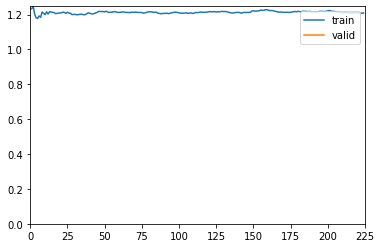

In [ ]:
learner.fit_one_cycle(1, 1e-8)

epoch,train_loss,valid_loss,F1,Lbbox,Ly,Lmask,Lbin,Lfloat,time
0,0.926629,0.878672,0.673333,0.198167,0.024971,0.080930,0.605779,0.080394,00:14
1,0.811980,0.832581,0.990000,0.120323,0.024404,0.075923,0.603900,0.080395,00:14
2,0.821347,0.828750,1.000000,0.098185,0.024217,0.080167,0.603339,0.084043,00:14
3,0.801061,0.824860,1.000000,0.086958,0.021993,0.090326,0.599481,0.080578,00:14
4,0.777990,0.797554,0.990000,0.076197,0.020228,0.074811,0.595944,0.078587,00:14
5,0.781158,0.799967,0.990000,0.072545,0.019698,0.076766,0.596482,0.080597,00:14
6,0.768134,0.792169,1.000000,0.068870,0.019430,0.075730,0.594097,0.078192,00:14
7,0.766738,0.787689,1.000000,0.059561,0.018980,0.077131,0.593302,0.077987,00:14
8,0.750432,0.783417,1.000000,0.055731,0.019351,0.074465,0.593767,0.077644,00:14
9,0.746821,0.783489,1.000000,0.056018,0.019175,0.074690,0.592938,0.078265,00:14


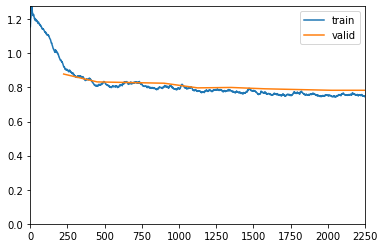

In [ ]:
learner.fit_one_cycle(10, 1e-3)

In [ ]:
save_inference(learner, 'east_bbox_5x3_resnet18_2')

epoch,train_loss,valid_loss,F1,Lbbox,Ly,Lmask,Lbin,Lfloat,time
0,0.853886,0.864863,0.940000,0.153199,0.080162,0.116260,0.610503,0.079759,00:14


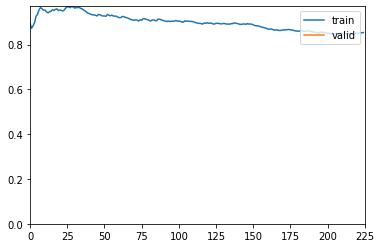

In [ ]:
learner.fit_one_cycle(1, 1e-3)

bin: BlinkConfidence;DarkGlassesConfidence;ExpressionConfidence;FaceDarknessConfidence;GlassesConfidence;GlassesReflectionConfidence;LookingAwayConfidence;MouthOpenConfidence;SkinReflectionConfidence;UnnaturalSkinToneConfidence
total found bbs: tensor(1002, device='cuda:0')
after nms: 2
total found bbs: tensor(614, device='cuda:0')
after nms: 2
total found bbs: tensor(1869, device='cuda:0')
after nms: 2
total found bbs: tensor(911, device='cuda:0')
after nms: 2


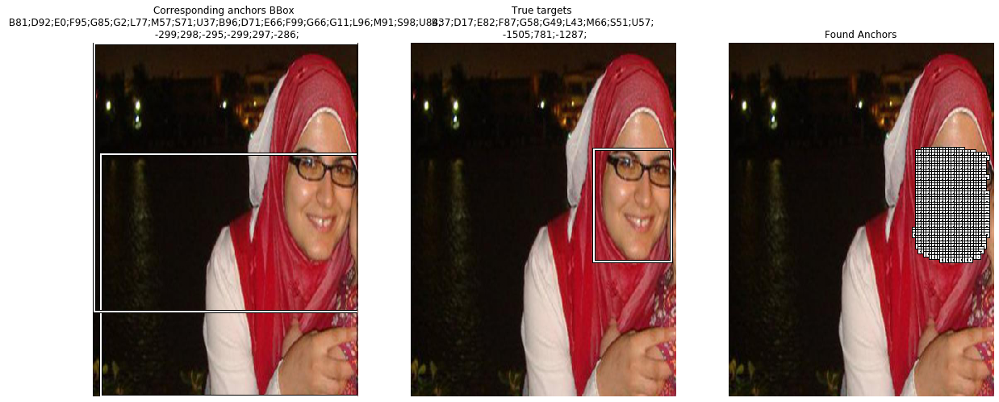

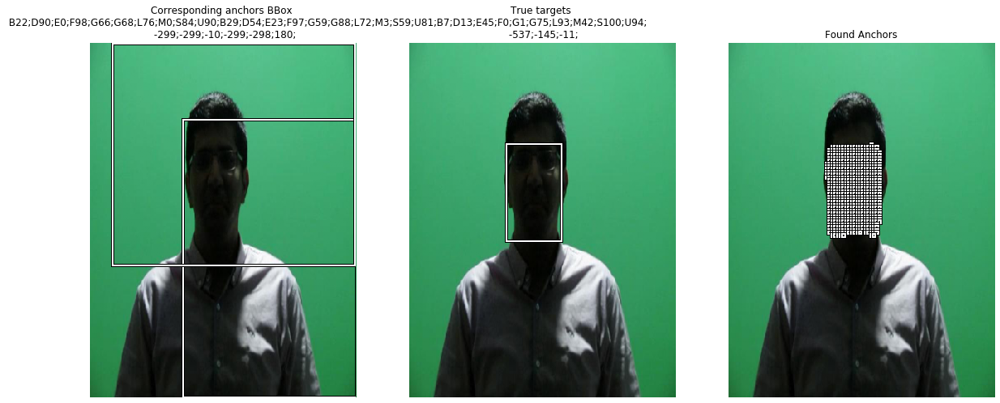

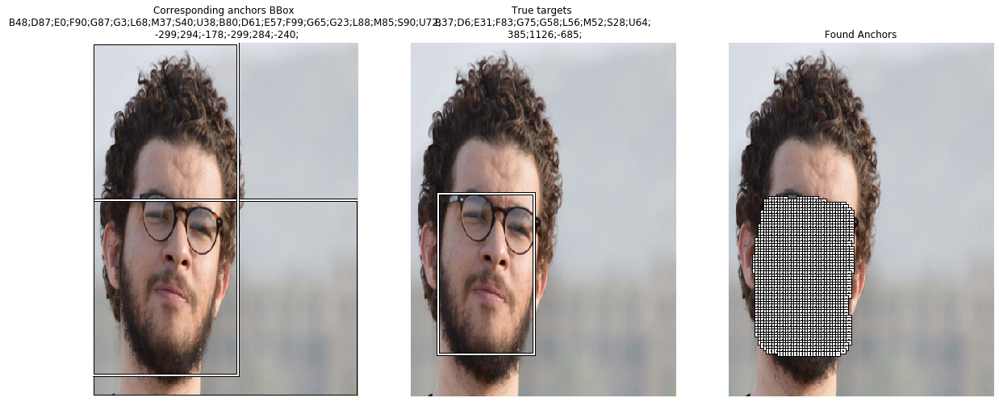

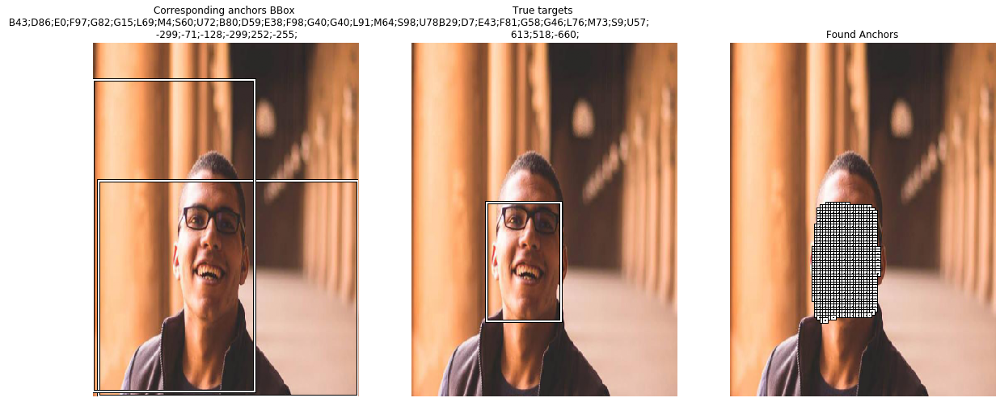

In [ ]:
show_examples(learner, image_count=4, detect_thresh=0.8, show_bbox=True, bin_newline=False, datatype=DatasetType.Train)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 1.58E-02
Min loss divided by 10: 9.12E-02


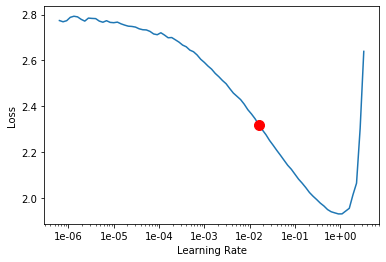

In [ ]:
learner.lr_find()
learner.recorder.plot(suggestion=True)

epoch,train_loss,valid_loss,F1,Lmask,Lbbox,Ly,Lbin,Lfloat,time
0,1.956987,1.688438,0.006429,0.791716,2.107500,0.582666,0.695115,0.080973,00:30


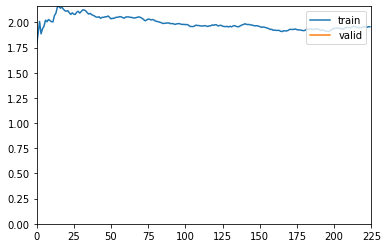

In [ ]:
learner.fit_one_cycle(1, 1e-8)

epoch,train_loss,valid_loss,F1,Lmask,Lbbox,Ly,Lbin,Lfloat,time
0,0.370834,0.368814,0.873040,0.187600,0.078587,0.031044,0.615229,0.289607,20:59


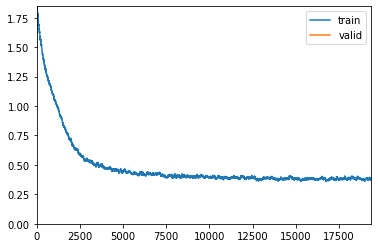

In [ ]:
learner.fit_one_cycle(1, 1e-4)

bin: BlinkConfidence;DarkGlassesConfidence;ExpressionConfidence;FaceDarknessConfidence;GlassesConfidence;GlassesReflectionConfidence;LookingAwayConfidence;MouthOpenConfidence;SkinReflectionConfidence;UnnaturalSkinToneConfidence
total found bbs: tensor(910, device='cuda:0')
after nms: 1
total found bbs: tensor(910, device='cuda:0')
after nms: 1
total found bbs: tensor(820, device='cuda:0')
after nms: 1
total found bbs: tensor(1570, device='cuda:0')
after nms: 1


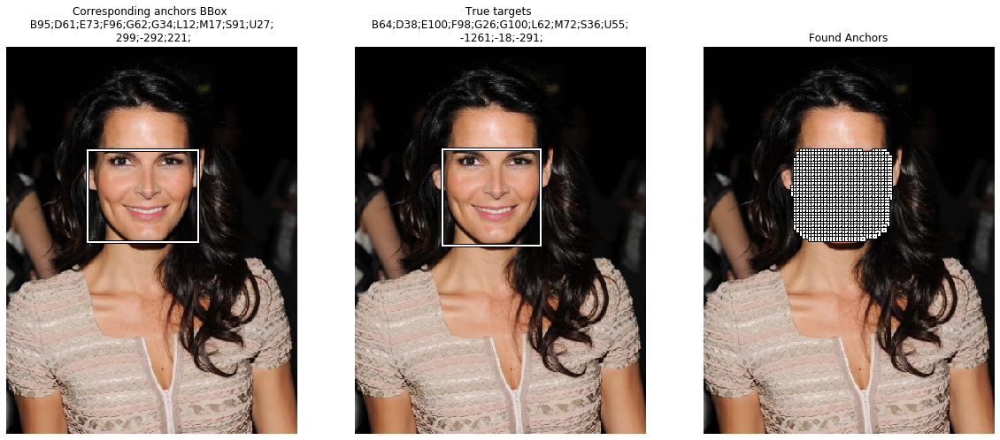

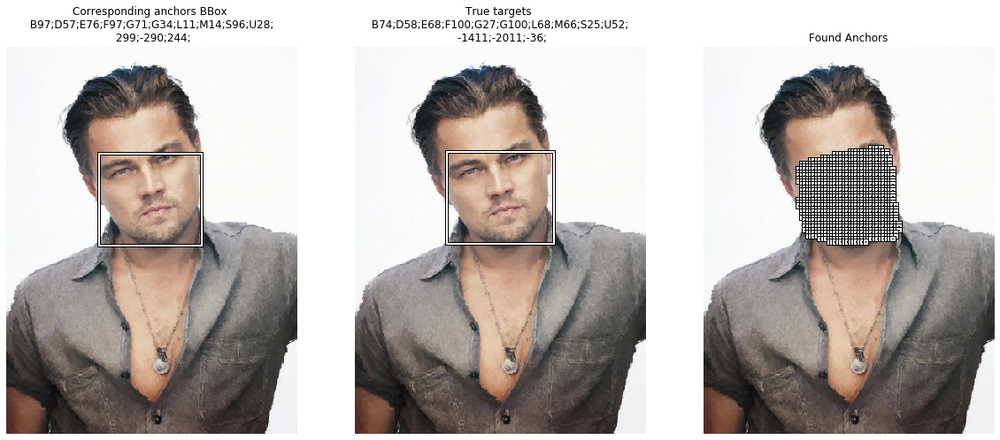

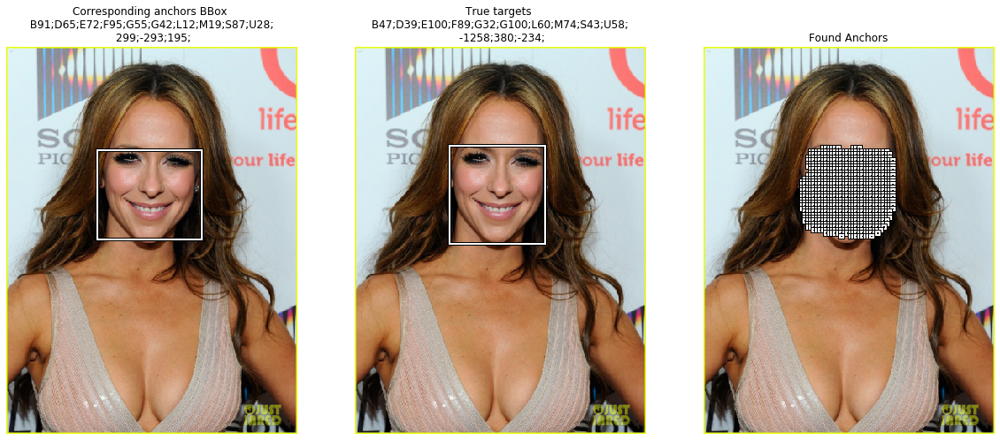

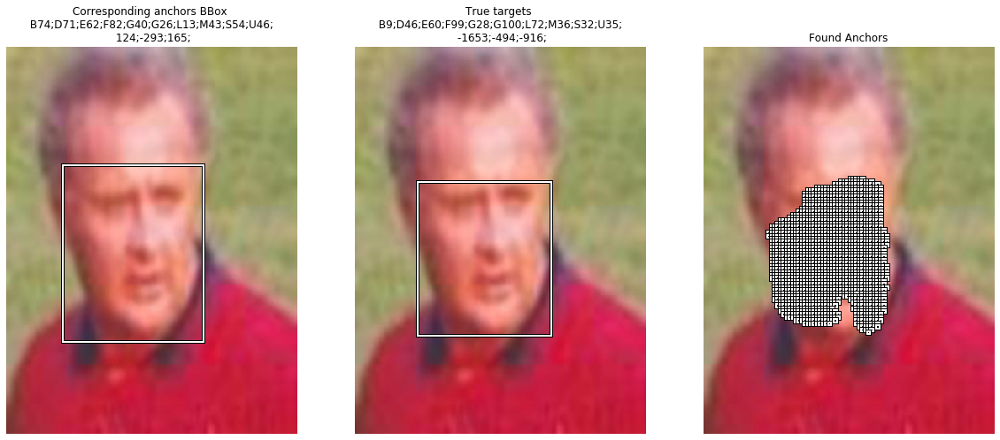

In [ ]:
show_examples(learner, image_count=4, detect_thresh=0.8, show_bbox=True, bin_newline=False, datatype=DatasetType.Train)

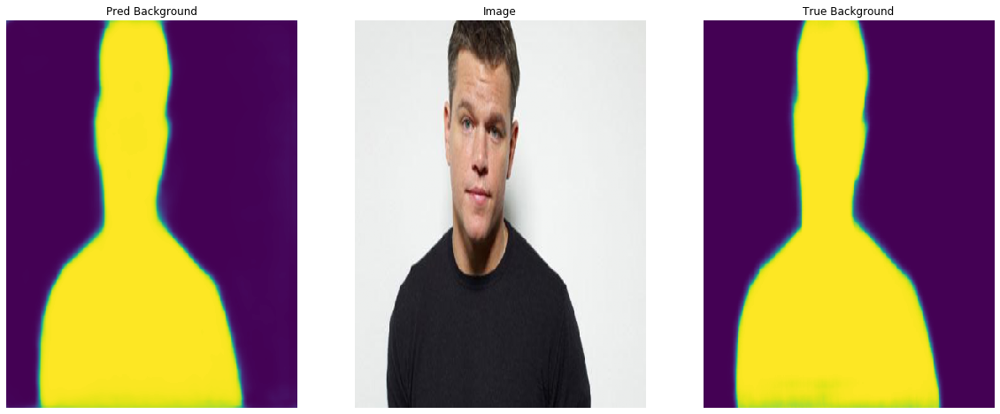

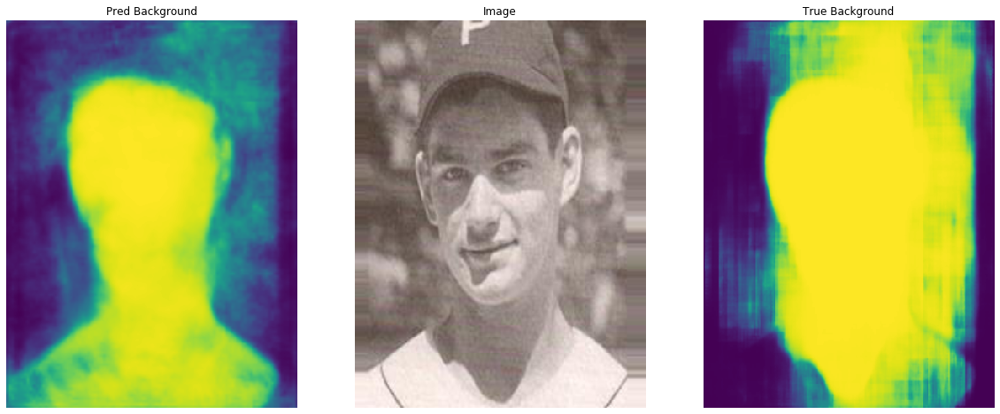

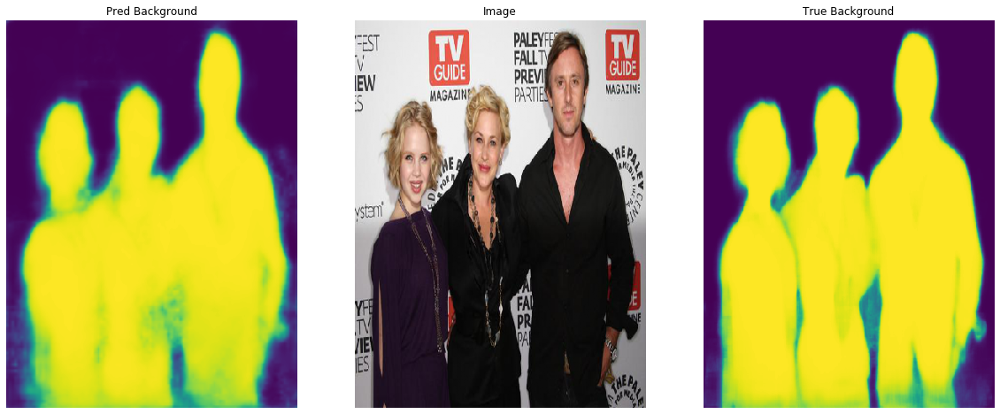

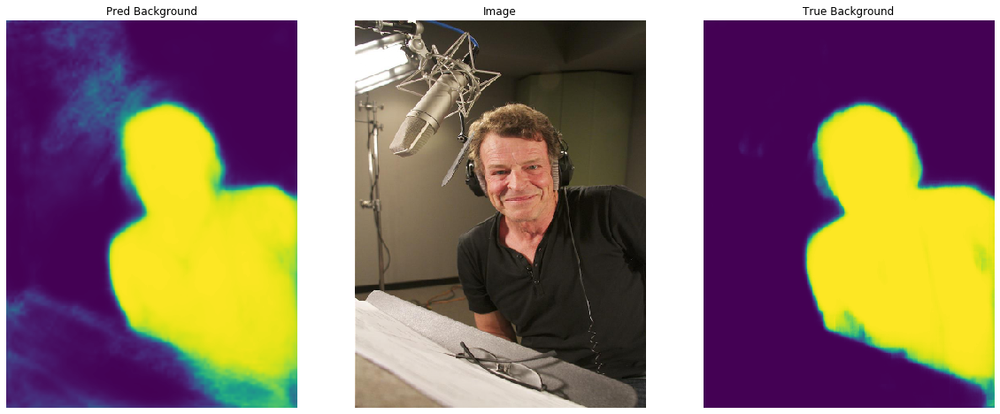

In [ ]:
show_mask_examples(learner, image_count=4, datatype=DatasetType.Valid)

In [ ]:
# learner.loss_func = RetinaNetFocalLoss(anchors, class_weights=[1/4,1/4,1/4,1/4], mask_weight=1.0)
# learner.data = create_data(src, transforms=None)

epoch,train_loss,valid_loss,F1,Lmask,Lbbox,Ly,Lbin,Lfloat,time
0,0.364307,0.360880,0.842215,0.182761,0.071201,0.027894,0.613381,0.283383,20:56
1,0.360248,0.352533,0.907193,0.178357,0.059974,0.024096,0.612635,0.287377,20:58
2,0.349434,0.348406,0.886682,0.176599,0.055174,0.022670,0.609384,0.276914,20:59
3,0.349128,0.346161,0.891752,0.174869,0.053618,0.022443,0.609104,0.281306,20:59


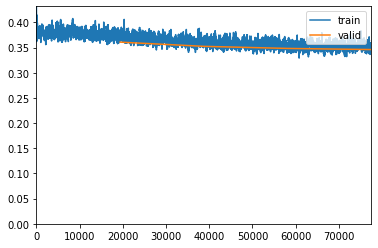

In [ ]:
learner.fit_one_cycle(4, 1e-4)

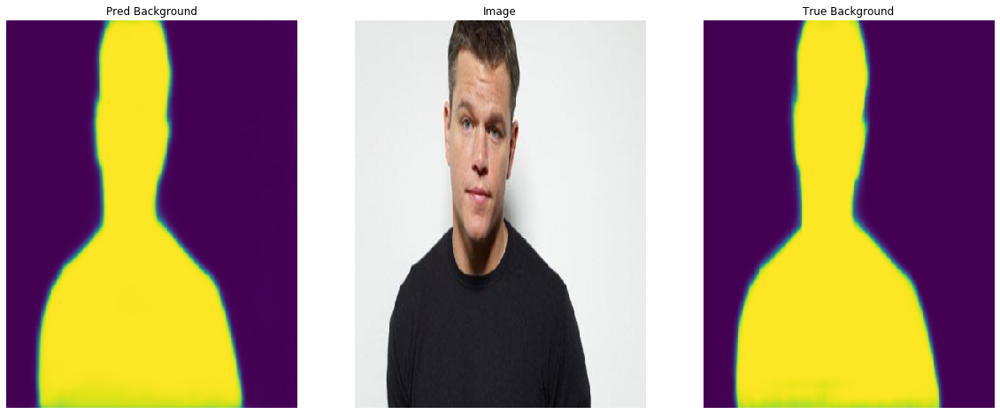

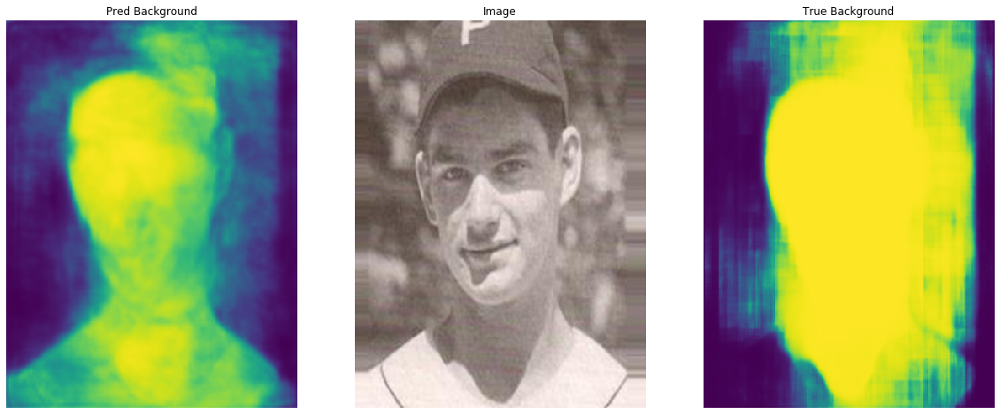

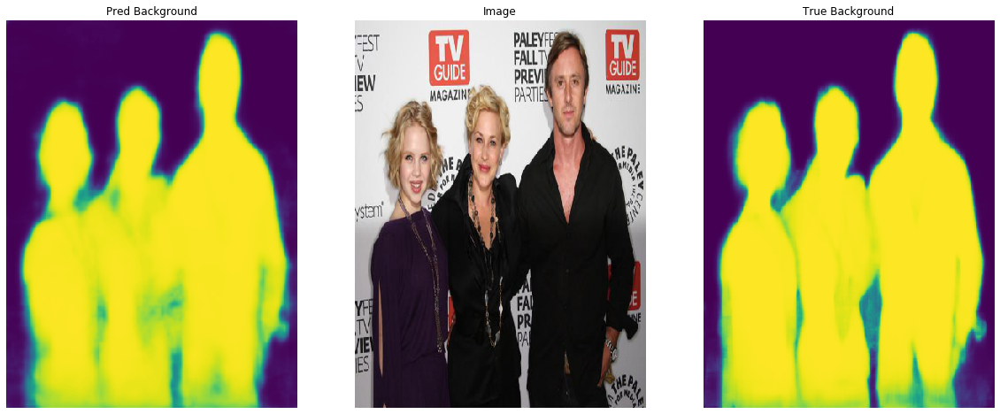

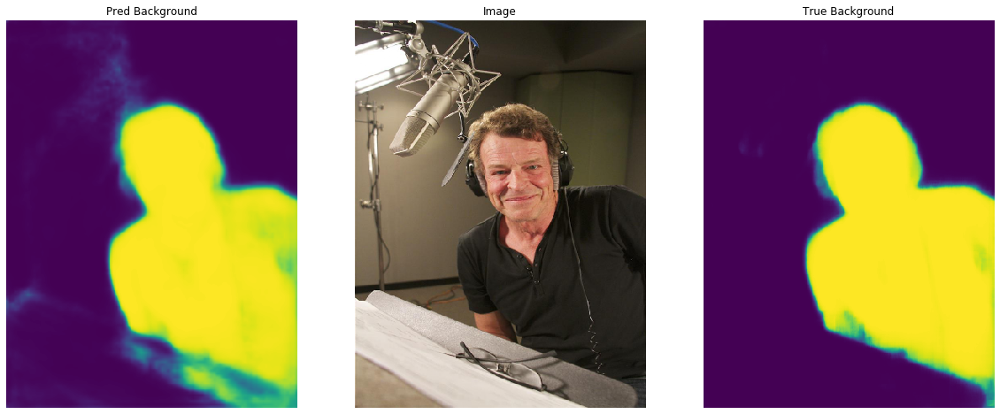

In [ ]:
show_mask_examples(learner, image_count=4, datatype=DatasetType.Valid)

bin: BlinkConfidence;DarkGlassesConfidence;ExpressionConfidence;FaceDarknessConfidence;GlassesConfidence;GlassesReflectionConfidence;LookingAwayConfidence;MouthOpenConfidence;SkinReflectionConfidence;UnnaturalSkinToneConfidence
total found bbs: tensor(1226, device='cuda:0')
after nms: 1
total found bbs: tensor(1397, device='cuda:0')
after nms: 1
total found bbs: tensor(2440, device='cuda:0')
after nms: 1
total found bbs: tensor(1501, device='cuda:0')
after nms: 1


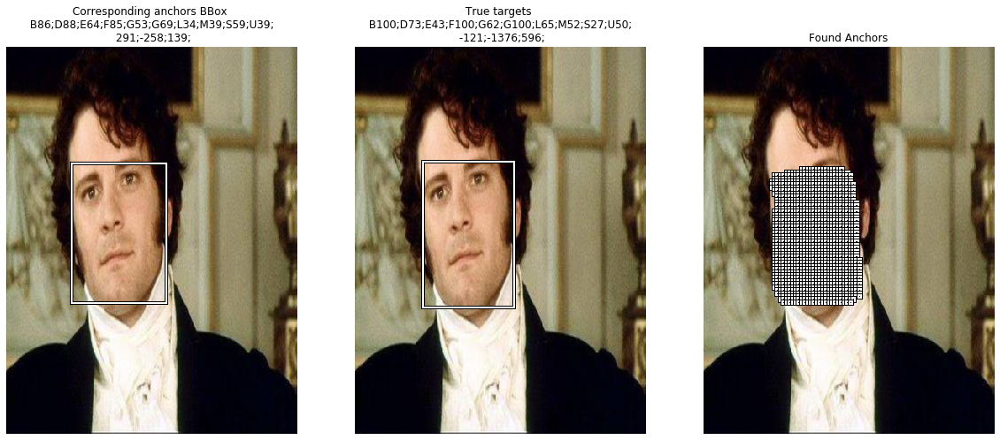

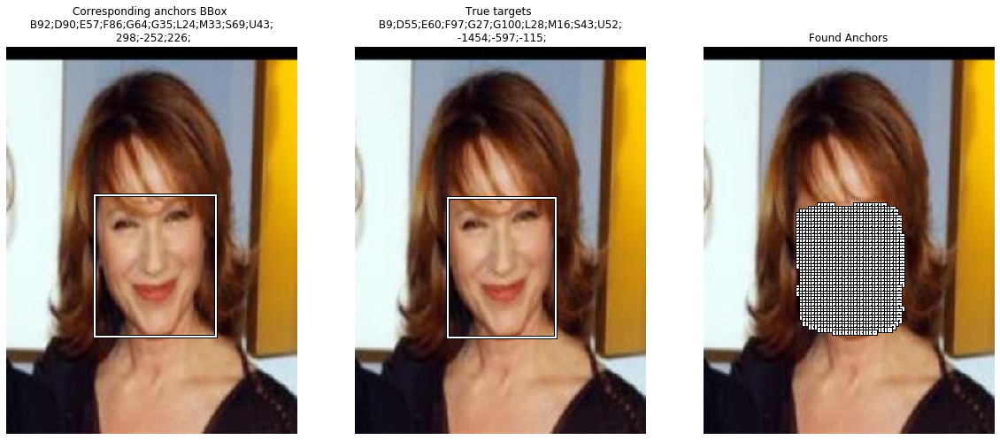

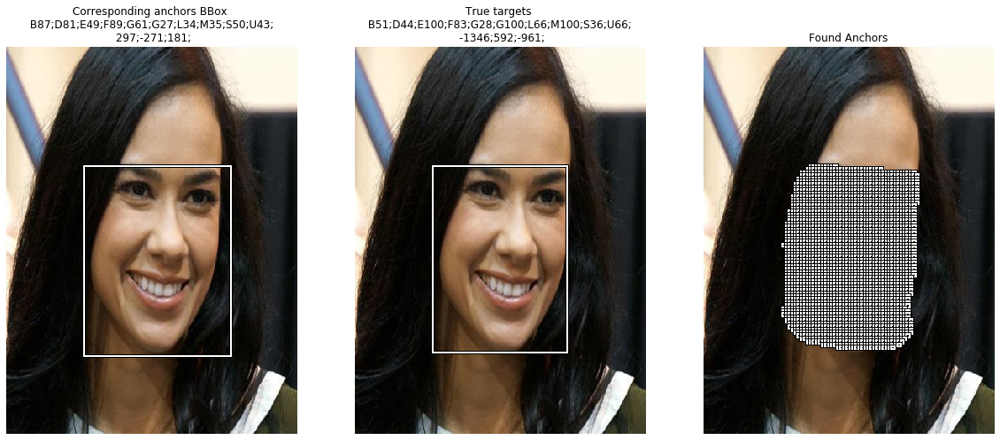

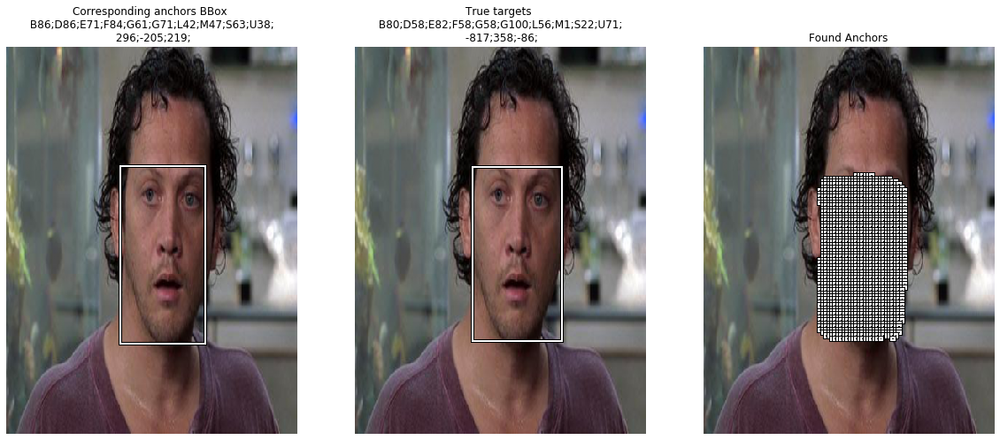

In [ ]:
show_examples(learner, image_count=4, detect_thresh=0.8, show_bbox=True, bin_newline=False, datatype=DatasetType.Train)

In [ ]:
save_inference(learner, 'east_bbox_5x3_resnet18_2')

PicklingError: Can't pickle <class '__main__.RetinaNetFocalLoss'>: it's not the same object as __main__.RetinaNetFocalLoss

epoch,train_loss,valid_loss,F1,Lmask,Lbbox,Ly,Lbin,Lfloat,time
0,0.353398,0.344245,0.957253,0.177844,0.043595,0.019157,0.602853,0.276233,25:02


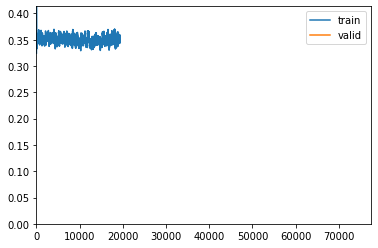

In [ ]:
learner.unfreeze()
learner.fit_one_cycle(4, 1e-4)

epoch,train_loss,valid_loss,F1,Lmask,Lbbox,Ly,Lbin,Lfloat,time
0,0.354884,0.349295,0.933994,0.177399,0.051030,0.021751,0.614803,0.219410,24:43


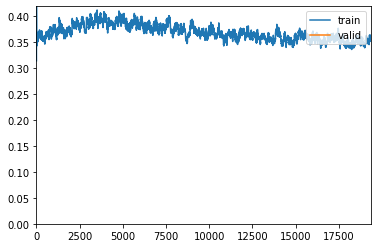

In [ ]:
learner.fit_one_cycle(1, 1e-3)

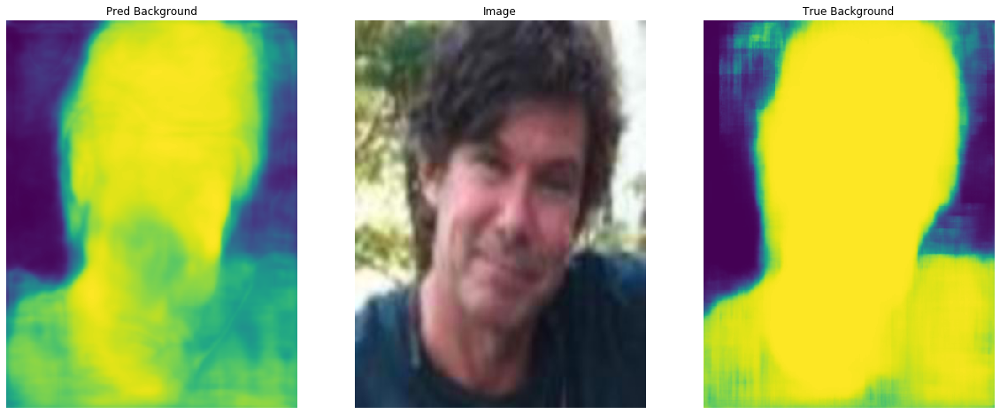

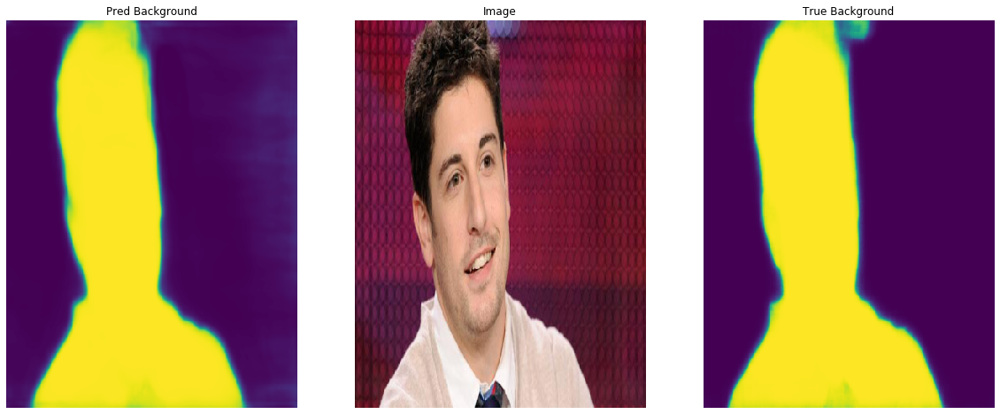

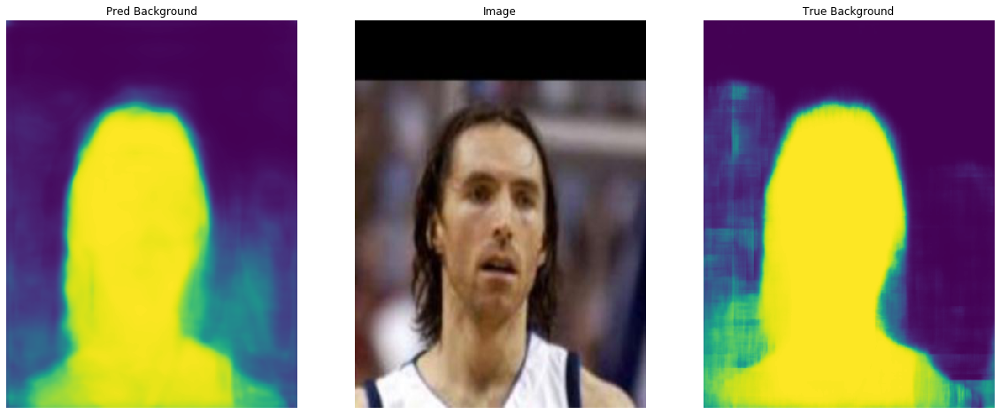

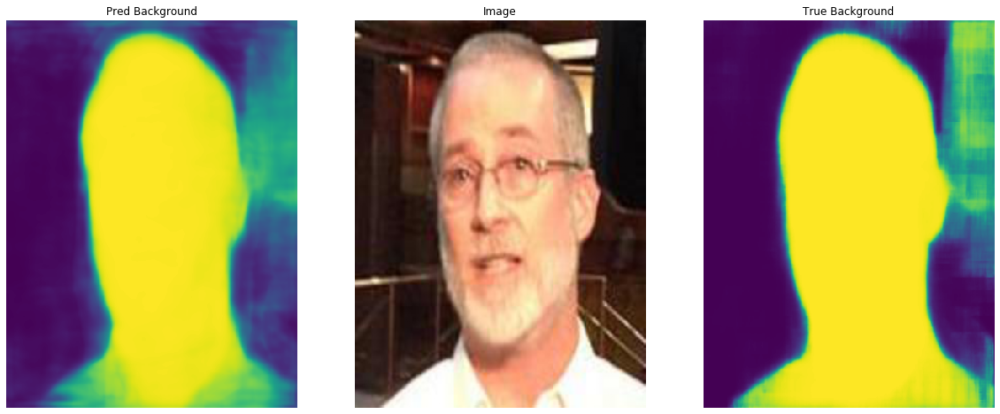

In [ ]:
show_mask_examples(learner, image_count=4, datatype=DatasetType.Train)

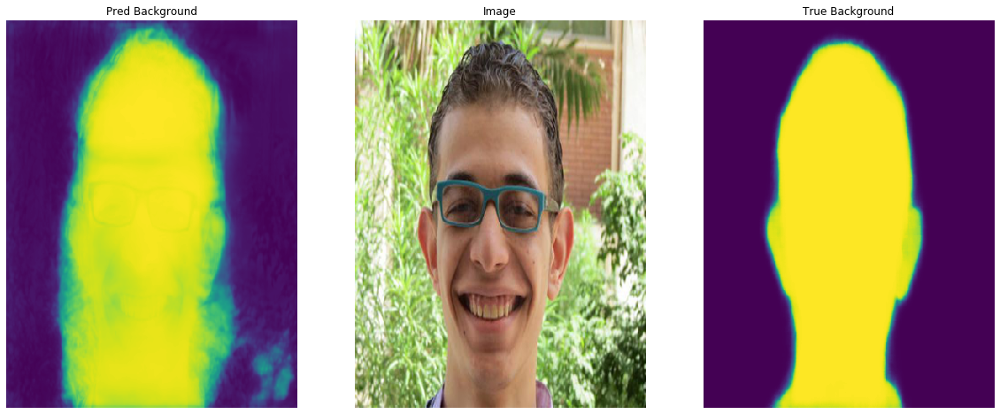

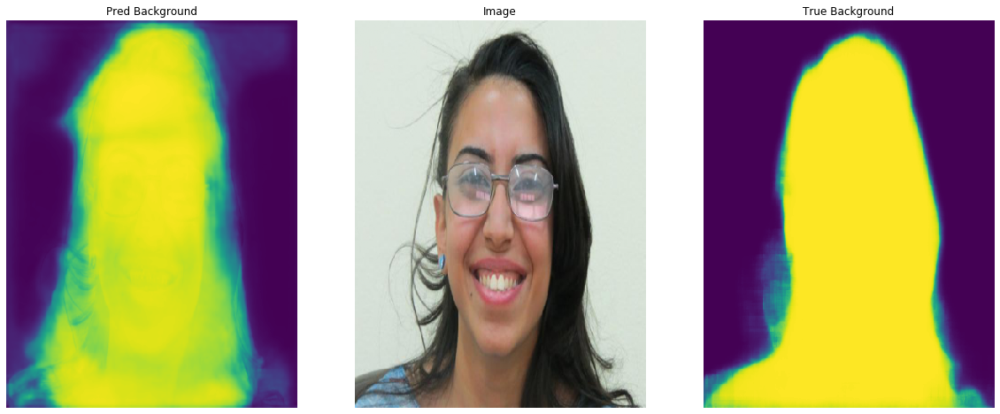

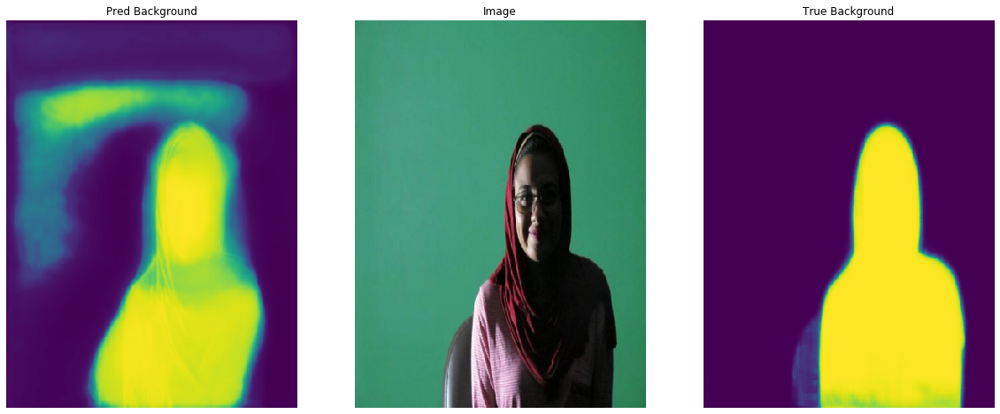

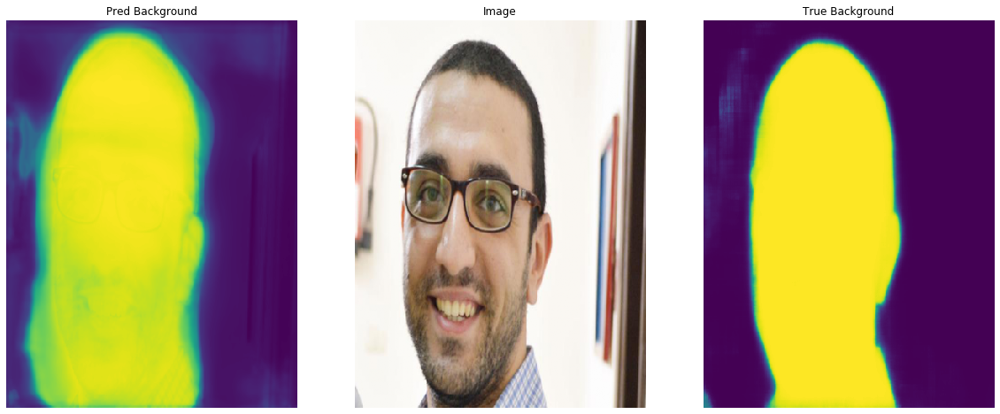

In [ ]:
show_mask_examples(learner, image_count=4, datatype=DatasetType.Valid)

bin: BlinkConfidence;ExpressionConfidence;FaceDarknessConfidence;GlassesConfidence;LookingAwayConfidence;MouthOpenConfidence
total found bbs: tensor(1066, device='cuda:0')
after nms: 1
total found bbs: tensor(559, device='cuda:0')
after nms: 1
total found bbs: tensor(966, device='cuda:0')
after nms: 2
total found bbs: tensor(1186, device='cuda:0')
after nms: 1


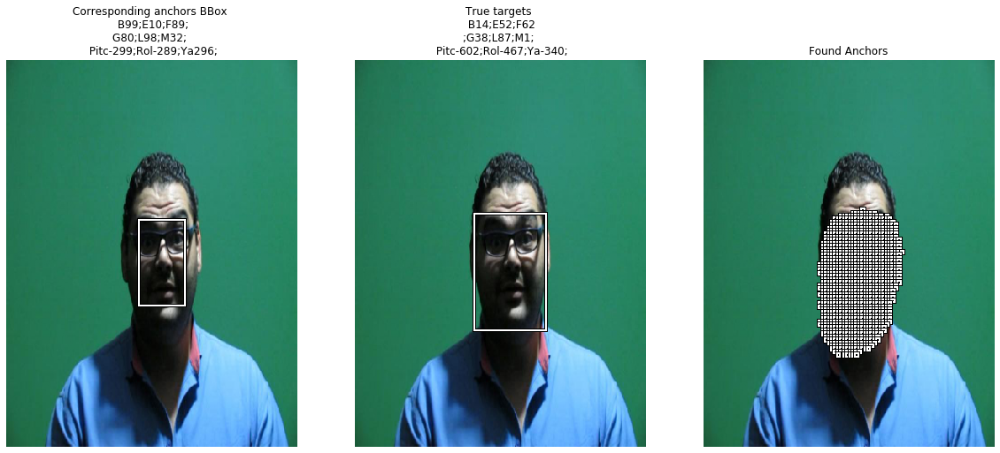

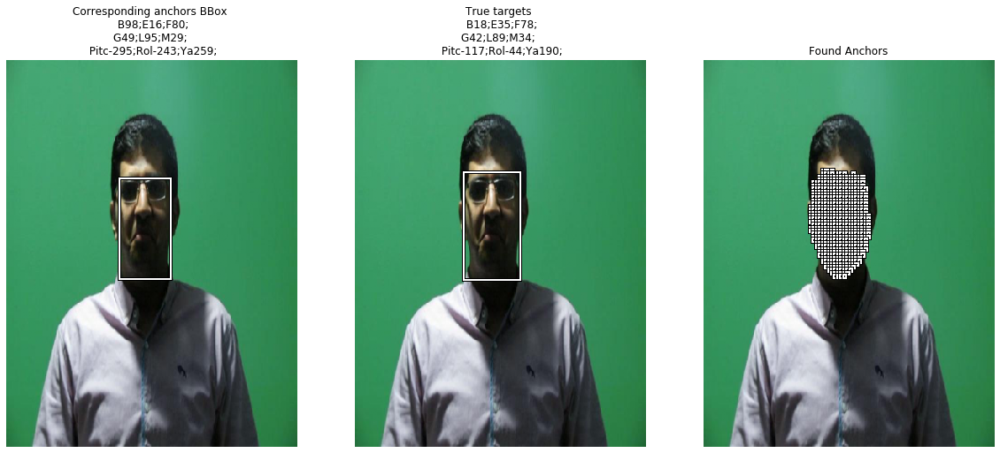

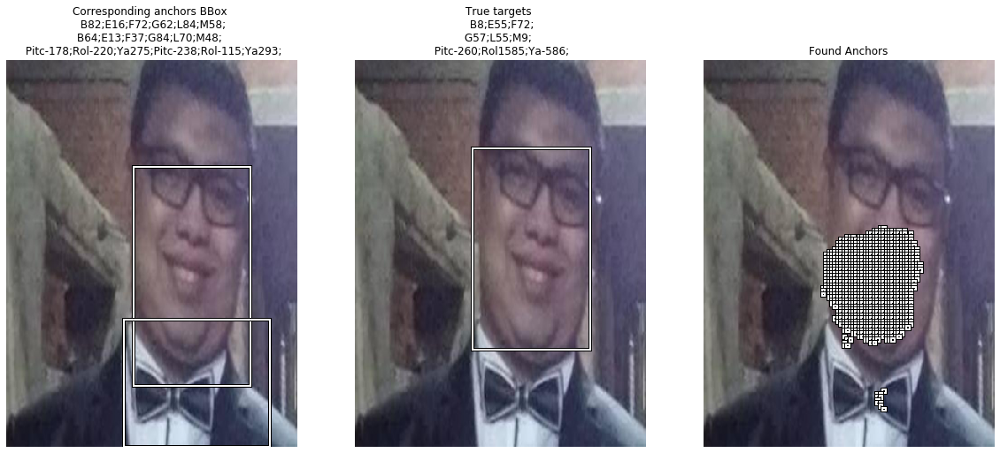

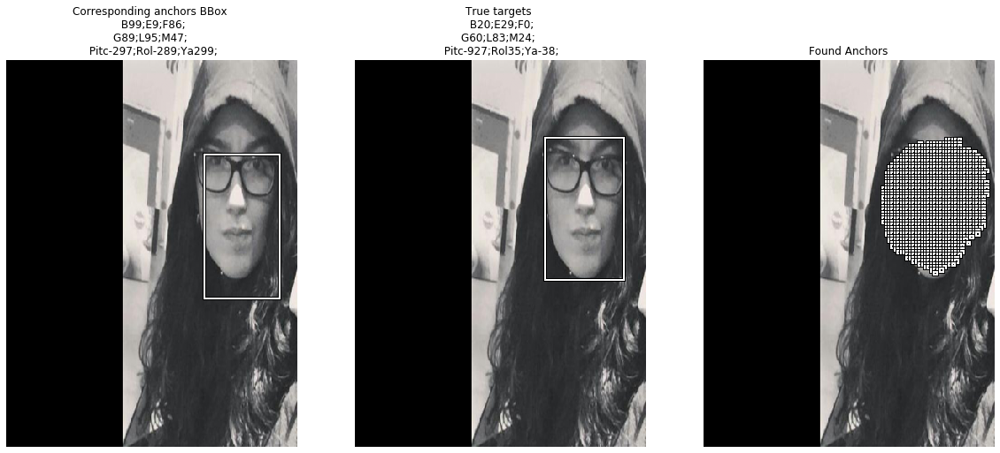

In [ ]:
show_examples(learner, image_count=4, detect_thresh=0.8, show_bbox=True)

epoch,train_loss,valid_loss,F1,Lbbox,Ly,Lbin,Lfloat,time
0,0.084503,0.083235,0.869073,0.057788,0.023657,0.184183,0.067311,18:50


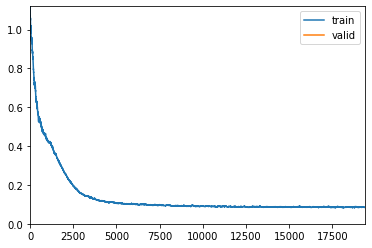

In [ ]:
learner.fit_one_cycle(1, 1e-4)

In [ ]:
save_inference(learner, 'east_bbox_5x3')

total found bbs: tensor(884, device='cuda:0')
after nms: 1
total found bbs: tensor(10, device='cuda:0')
after nms: 1
total found bbs: tensor(2275, device='cuda:0')
after nms: 1
total found bbs: tensor(1237, device='cuda:0')
after nms: 1


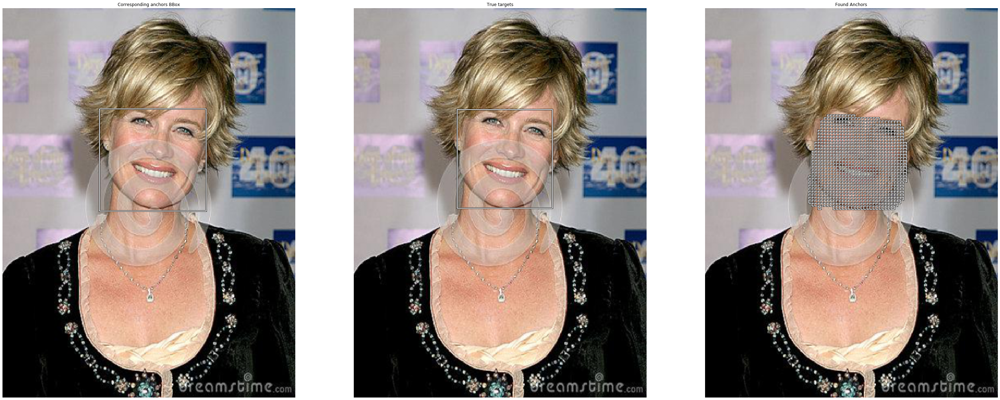

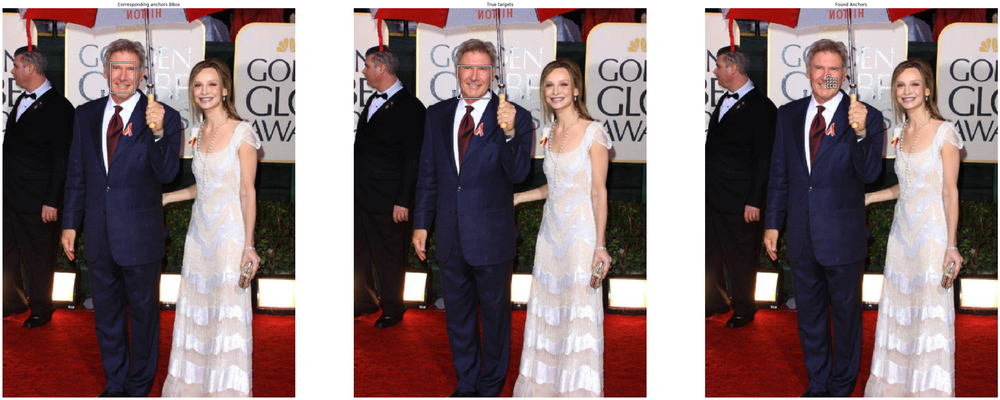

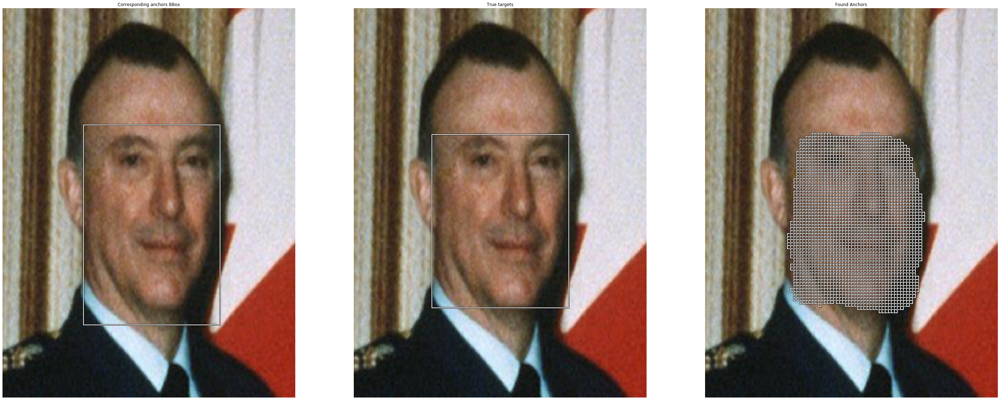

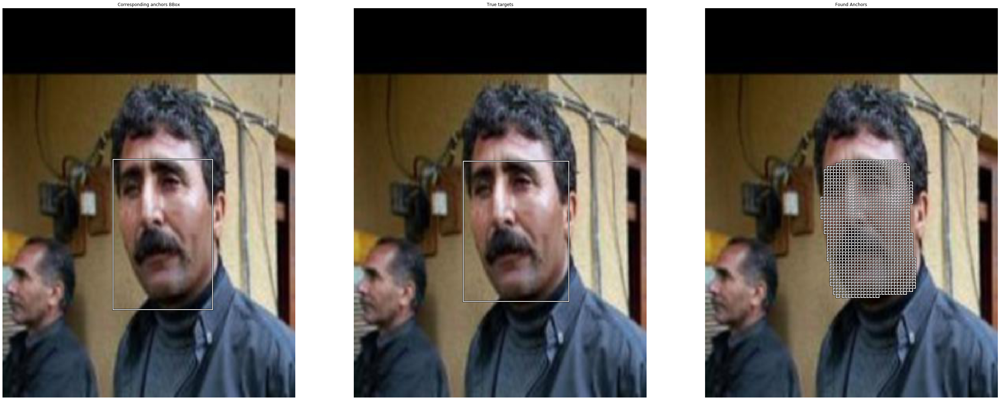

In [ ]:
show_examples(learner, image_count=4, detect_thresh=0.8, show_bbox=True)

epoch,train_loss,valid_loss,F1,Lbbox,Ly,Lbin,Lfloat,time
0,0.100615,0.098943,0.902840,0.053770,0.022073,0.183119,0.067347,18:47
1,0.097089,0.096086,0.890088,0.047467,0.019452,0.181551,0.067364,18:48
2,0.095786,0.093839,0.915669,0.041391,0.017941,0.180672,0.067373,18:53
3,0.094848,0.092592,0.903111,0.037867,0.017275,0.180177,0.067356,18:49
4,0.093264,0.092153,0.927938,0.036799,0.016935,0.179978,0.067282,18:49
5,0.092208,0.091855,0.930685,0.036062,0.016793,0.179785,0.067275,18:46


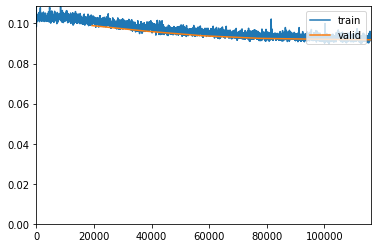

In [ ]:
learner.loss_func = RetinaNetFocalLoss(anchors, class_weights=[0.25,0.25,0.4,0.1])
learner.fit_one_cycle(6, 1e-4)

In [ ]:
save_inference(learner, 'east_bbox_5x3')

total found bbs: tensor(940, device='cuda:0')
after nms: 1


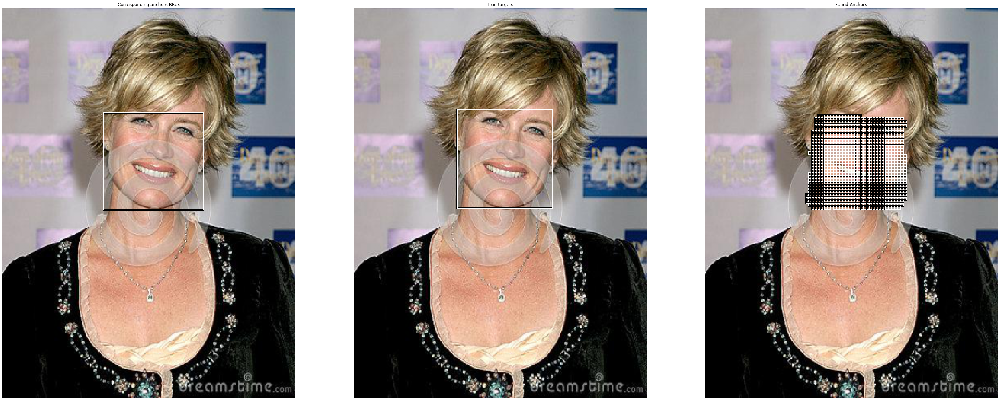

In [ ]:
show_examples(learner, image_count=1, detect_thresh=0.8, show_bbox=True)

In [ ]:
F1_50 = partial(F1, iou_thresh=0.5)
F1_80 = partial(F1, iou_thresh=0.8)

epoch,train_loss,valid_loss,F1,F1,Lbbox,Ly,Lbin,Lfloat,time
0,0.091748,0.090628,0.949726,0.932466,0.032740,0.015583,0.179548,0.067277,23:52
1,0.090154,0.089036,0.927222,0.915766,0.029457,0.014377,0.178496,0.066788,23:44
2,0.089028,0.087690,0.920217,0.909458,0.026809,0.013563,0.177814,0.064709,23:47
3,0.086217,0.086610,0.941638,0.935369,0.024902,0.012939,0.177214,0.062643,23:52
4,0.085806,0.085945,0.951507,0.944308,0.024082,0.012716,0.176460,0.061621,23:50
5,0.085602,0.085877,0.948391,0.942702,0.024108,0.012640,0.176330,0.061581,23:50


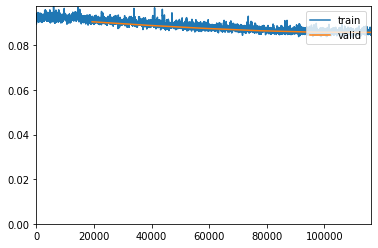

In [ ]:
learner.metrics = [F1_50,F1_80]
learner.unfreeze()
learner.fit_one_cycle(6, slice(1e-5,1e-4))

bin: BackgroundUniformity;BlinkConfidence;Contrast;DarkGlassesConfidence;DetectionConfidence;ExpressionConfidence;FaceDarknessConfidence;GlassesConfidence;GlassesReflectionConfidence;GrayscaleDensity;LookingAwayConfidence;MouthOpenConfidence;Noise;PixelationConfidence;Quality;RedEyeConfidence;Saturation;Sharpness;SkinReflectionConfidence;UnnaturalSkinToneConfidence;WashedOutConfidence
total found bbs: tensor(2101, device='cuda:0')
after nms: 1
total found bbs: tensor(241, device='cuda:0')
after nms: 1
total found bbs: tensor(2062, device='cuda:0')
after nms: 1
total found bbs: tensor(2973, device='cuda:0')
after nms: 1


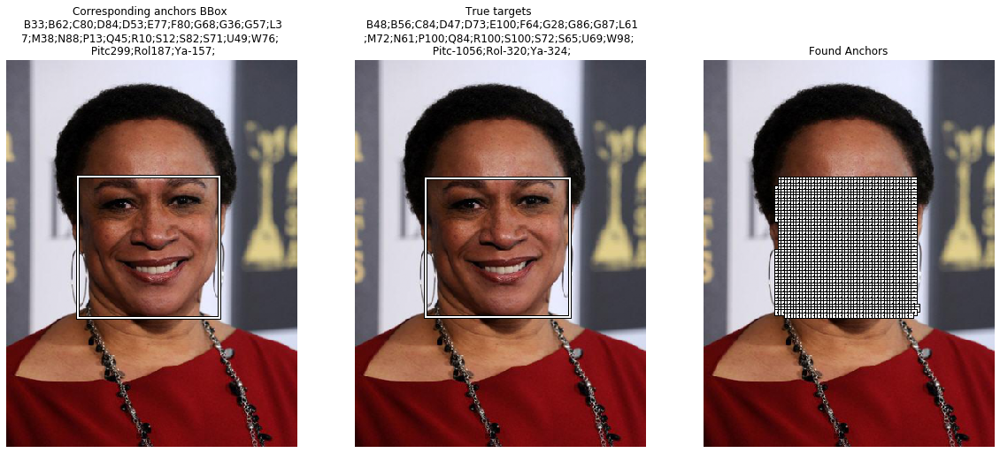

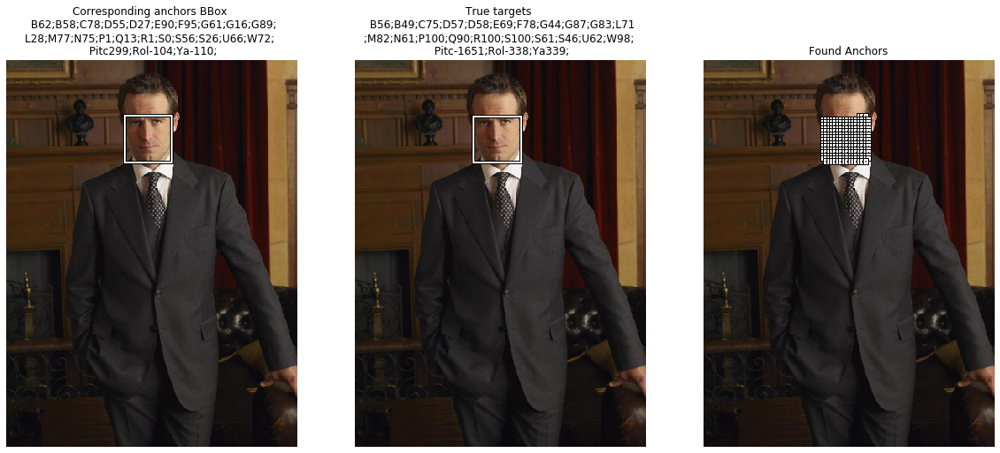

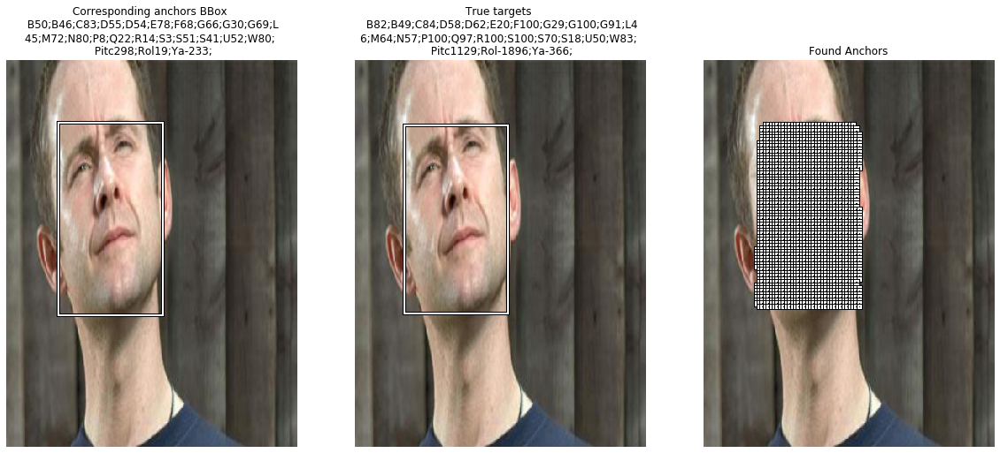

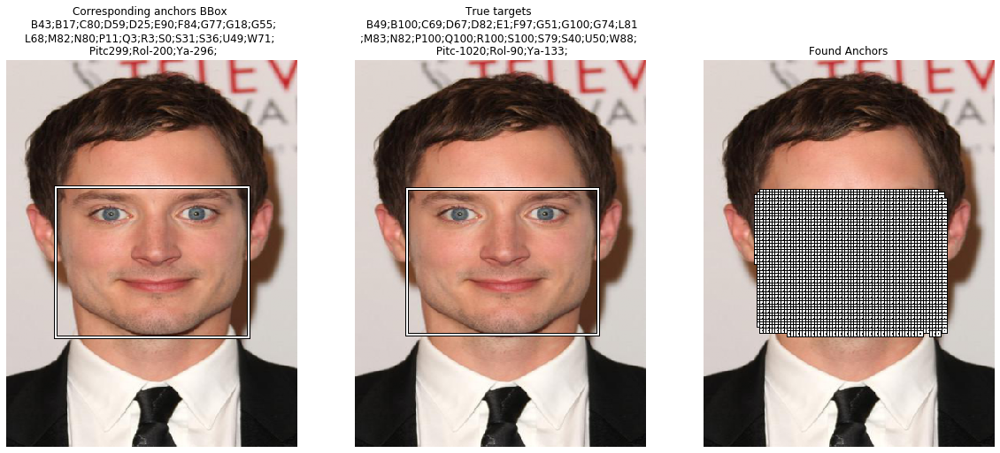

In [ ]:
show_examples(learner, image_count=4, detect_thresh=0.8, show_bbox=True)

In [ ]:
learner.loss_func = RetinaNetFocalLoss(anchors, class_weights=[0.,0.1,0.,0.9])
learner.fit_one_cycle(1, 1e-4)

epoch,train_loss,valid_loss,F1,F1,Lbbox,Ly,Lbin,Lfloat,time


KeyboardInterrupt: 

bin: BackgroundUniformity;BlinkConfidence;Contrast;DarkGlassesConfidence;DetectionConfidence;ExpressionConfidence;FaceDarknessConfidence;GlassesConfidence;GlassesReflectionConfidence;GrayscaleDensity;LookingAwayConfidence;MouthOpenConfidence;Noise;PixelationConfidence;Quality;RedEyeConfidence;Saturation;Sharpness;SkinReflectionConfidence;UnnaturalSkinToneConfidence;WashedOutConfidence
total found bbs: tensor(2101, device='cuda:0')
after nms: 1
total found bbs: tensor(241, device='cuda:0')
after nms: 1
total found bbs: tensor(2062, device='cuda:0')
after nms: 1
total found bbs: tensor(2973, device='cuda:0')
after nms: 1


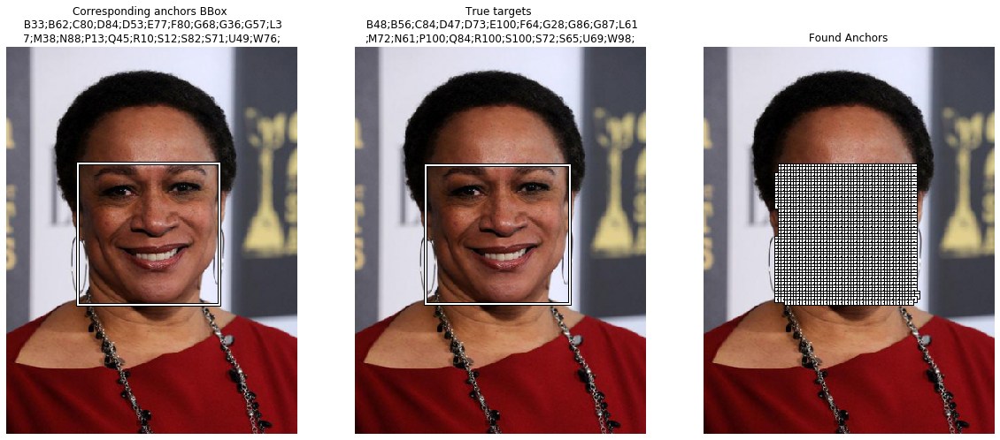

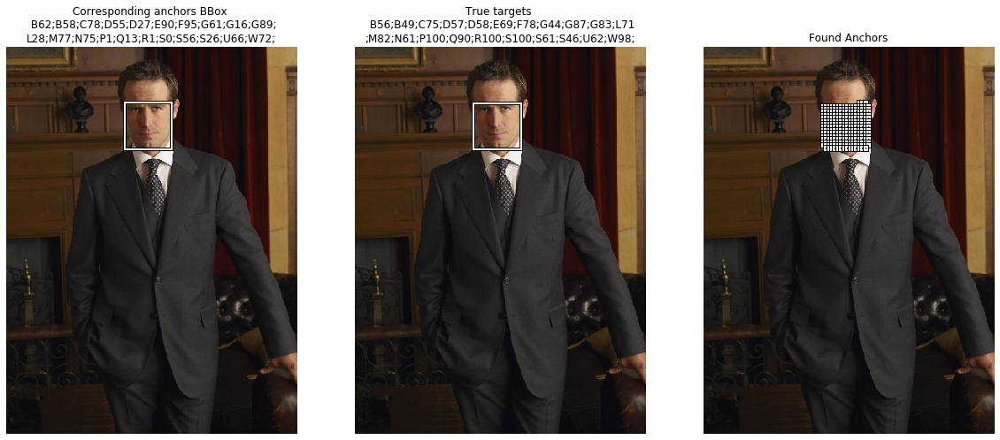

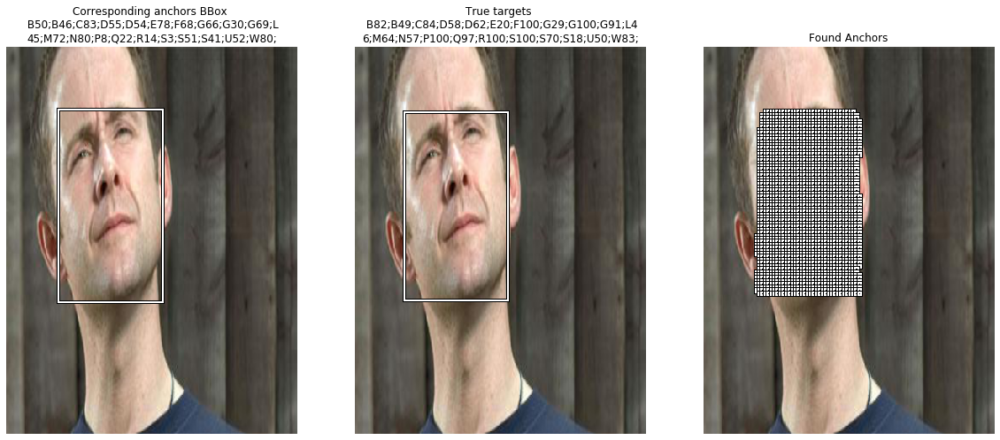

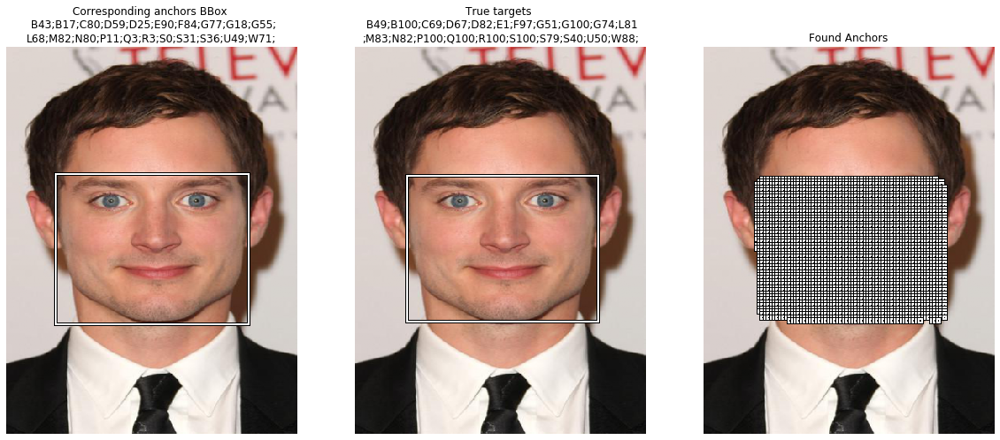

In [ ]:
show_examples(learner, image_count=4, detect_thresh=0.8, show_bbox=True)

In [ ]:
save_inference(learner, 'east_bbox_5x3_resnet18')

In [ ]:
1

1

total found bbs: tensor(2101, device='cuda:0')
after nms: 1
total found bbs: tensor(241, device='cuda:0')
after nms: 1
total found bbs: tensor(2062, device='cuda:0')
after nms: 1
total found bbs: tensor(2973, device='cuda:0')
after nms: 1


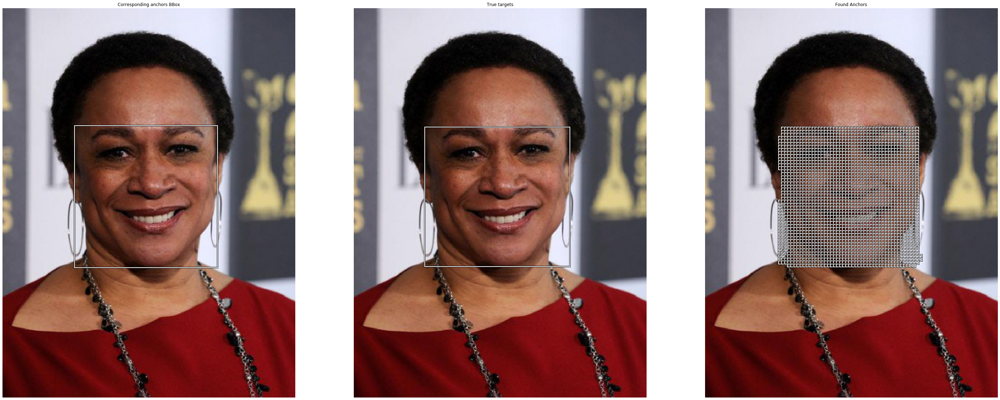

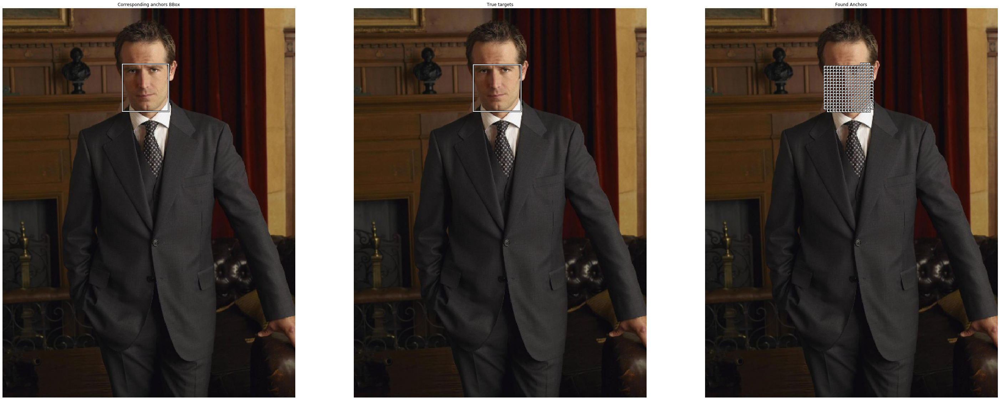

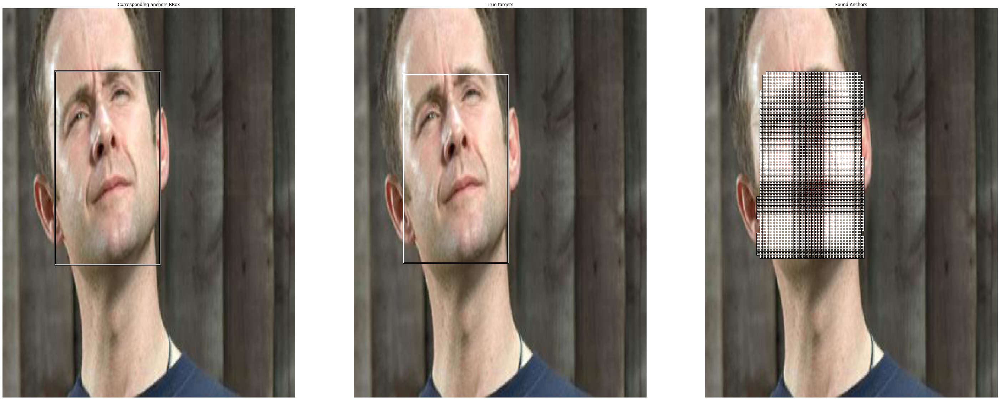

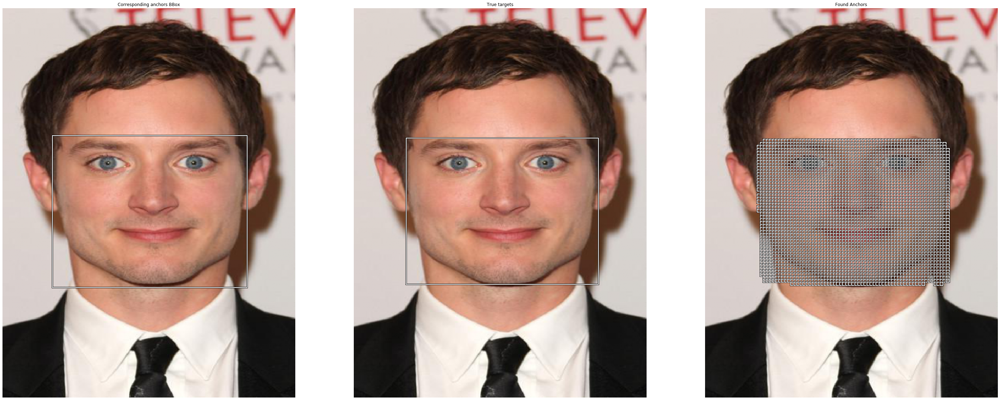

In [ ]:
show_examples(learner, image_count=4, detect_thresh=0.8, show_bbox=True)

### w/ greek isir dataset

In [ ]:
learner = load_inference('east_bbox_10x3')
learner.data = data

In [ ]:
F1_50 = partial(F1, iou_thresh=0.5)
F1_80 = partial(F1, iou_thresh=0.8)

epoch,train_loss,valid_loss,F1,F1,bbox_loss,class_loss,time
0,0.077941,0.047923,0.965402,0.788780,0.065812,0.030034,01:40
1,0.060672,0.052811,0.964230,0.709296,0.073497,0.032125,01:40
2,0.066366,0.049616,0.967436,0.780870,0.070015,0.029217,01:40
3,0.064050,0.049617,0.965952,0.761850,0.070397,0.028836,01:41
4,0.060460,0.054631,0.966211,0.726989,0.074306,0.034956,01:41
5,0.055278,0.049406,0.968070,0.767572,0.070322,0.028490,01:41
6,0.052476,0.050173,0.969042,0.731536,0.071537,0.028809,01:41
7,0.048083,0.045832,0.969559,0.803241,0.063690,0.027974,01:42
8,0.046251,0.045386,0.970339,0.813182,0.063264,0.027507,01:41
9,0.045612,0.045047,0.970168,0.813686,0.062866,0.027228,01:41


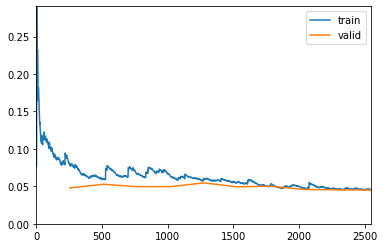

In [ ]:
learner.metrics = [F1_50,F1_80]
learner.loss_func = RetinaNetFocalLoss(anchors, class_loss_weight=0.5)
learner.fit_one_cycle(10, 1e-3)

In [ ]:
save_inference(learner, 'east_bbox_10x3')

total found bbs: tensor(4823, device='cuda:0')
after nms: 42


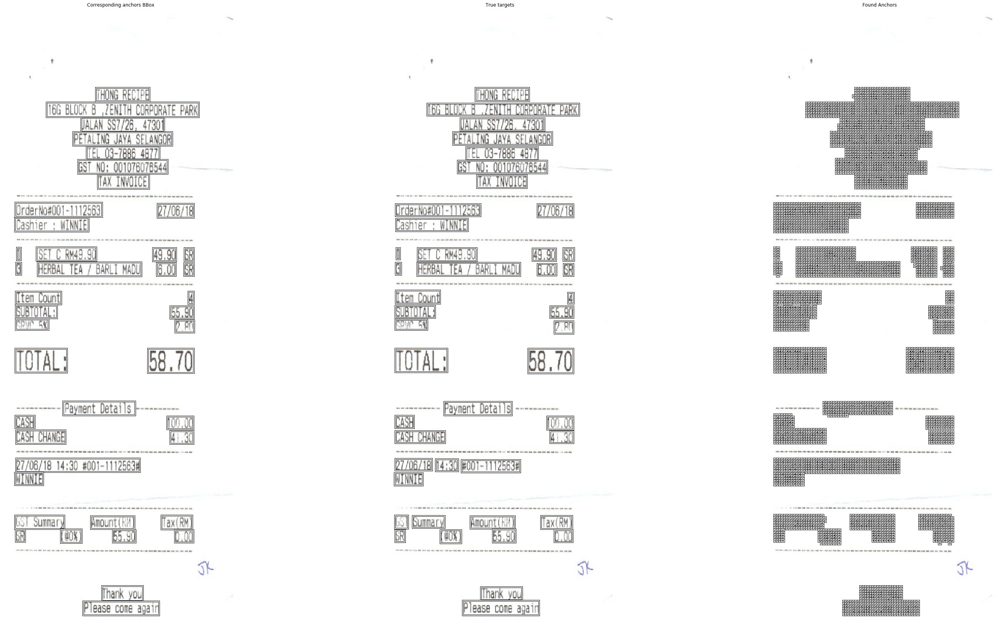

In [ ]:
show_examples(learner, image_count=1, detect_thresh=0.8, show_bbox=True)